#AMAZON PRODUCT SALES **ANALYSIS**

##TABLE OF CONTENT

(1) Data Collection

(2) Data Inspection

     (shape,dtypes,content) for basic
     understanding
     checking for missing values,outliers and any data quality issues
     
(3)  Data Cleaning

  (a) Handling Missing values

        Remove rows/columns with grater than 70% missing values if neccessary

        Fill null values with 0

        Impute/replace null values using methods like mean, median,mode or more advanced techniques

  (b) Remove Duplicates

        Identify and remove duplicates
(4) Data Transformation

  (a) Convert Data Types

        Ensure that each column has correct data types
  (b) Feature Scalling

        Standardize and normalize numerical features to ensure they have simialr scales
  (c) Feature Engineering

        Create new features that may be more informative for the analysis or modelling
        Transform existing features
(5) Data Visualization

  (a) EDA
       Uni-variate analysis
       Bi-variate analysis
       Multi-variate analysis
       Summary statisctis
       Visualizations
       Insighs
(6) Distribution

(7) Hypothesis Testing

(8) Conclusion








###REQUIRED LIBRARIES

In [1]:
import pandas as pd # used for Data Manuplation and Handling
import numpy as np # used for Numerical operations
import statistics as stat # used for Statistical Calculations
import matplotlib.pyplot as plt # used for plotting graphs(python plotting package)
import seaborn as sb # used for visualization

###IMPORT DATA SET PATH

In [16]:
path = "/content/drive/MyDrive/Amazon_data/Amazon-Products.zip"
pd.set_option('display.expand_frame_repr', False)
data = pd.read_csv(path, low_memory = False)

In [17]:
data.head()

,Unnamed: 0,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price
0,0,Lloyd 1.5 Ton 3 Star Inverter Split Ac (5 In 1...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/31UISB90sY...,https://www.amazon.in/Lloyd-Inverter-Convertib...,4.2,"2,255","₹32,999","₹58,990"
1,1,LG 1.5 Ton 5 Star AI DUAL Inverter Split AC (C...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/51JFb7FctD...,https://www.amazon.in/LG-Convertible-Anti-Viru...,4.2,"2,948","₹46,490","₹75,990"
2,2,LG 1 Ton 4 Star Ai Dual Inverter Split Ac (Cop...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/51JFb7FctD...,https://www.amazon.in/LG-Inverter-Convertible-...,4.2,"1,206","₹34,490","₹61,990"
3,3,LG 1.5 Ton 3 Star AI DUAL Inverter Split AC (C...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/51JFb7FctD...,https://www.amazon.in/LG-Convertible-Anti-Viru...,4.0,69,"₹37,990","₹68,990"
4,4,Carrier 1.5 Ton 3 Star Inverter Split AC (Copp...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/41lrtqXPiW...,https://www.amazon.in/Carrier-Inverter-Split-C...,4.1,630,"₹34,490","₹67,790"


###To find Number of Rows in the Dataset

In [19]:
data.shape[0]


551585

###To Find Number of Columns in The Dataset

In [20]:
data.shape[1]

10

###Size of The Dataset

In [21]:
data.shape

(551585, 10)

### The structure And Integrity of the Dataset

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 551585 entries, 0 to 551584
Data columns (total 10 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   Unnamed: 0      551585 non-null  int64 
 1   name            551585 non-null  object
 2   main_category   551585 non-null  object
 3   sub_category    551585 non-null  object
 4   image           551585 non-null  object
 5   link            551585 non-null  object
 6   ratings         375791 non-null  object
 7   no_of_ratings   375791 non-null  object
 8   discount_price  490422 non-null  object
 9   actual_price    533772 non-null  object
dtypes: int64(1), object(9)
memory usage: 42.1+ MB


###To Display Column Names of The Dataset

In [23]:
data.columns

Index(['Unnamed: 0', 'name', 'main_category', 'sub_category', 'image', 'link',
       'ratings', 'no_of_ratings', 'discount_price', 'actual_price'],
      dtype='object')

###To Display Statistical values of The Dataset

In [24]:
data.describe()

,Unnamed: 0
count,551585.000000
mean,7006.200471
std,5740.835523
min,0.000000
25%,1550.000000
50%,5933.000000
75%,11482.000000
max,19199.000000


showing only for unnamed column because the data set contains only one numerical column rest are set to object type. we need to change them in data tranformation part

###To Display First 2 Rows of The Dataset

In [25]:
data.head(2)

,Unnamed: 0,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price
0,0,Lloyd 1.5 Ton 3 Star Inverter Split Ac (5 In 1...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/31UISB90sY...,https://www.amazon.in/Lloyd-Inverter-Convertib...,4.2,"2,255","₹32,999","₹58,990"
1,1,LG 1.5 Ton 5 Star AI DUAL Inverter Split AC (C...,appliances,Air Conditioners,https://m.media-amazon.com/images/I/51JFb7FctD...,https://www.amazon.in/LG-Convertible-Anti-Viru...,4.2,"2,948","₹46,490","₹75,990"


###Droping Unneccesary Columnd

we don't want image and link columns for analysis so we can remove them

In [26]:
columns_to_drop = ['image','link']
data =data.drop(columns=columns_to_drop)

we can see that Unamed: 0 columns just shows index, so it is useless, we can delete this one also

In [27]:
del data['Unnamed: 0'] # data.drop(columns='Unnamed: 0',inplace= True)

In [28]:

data.info() # info about column names,non null values,DTYPES

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 551585 entries, 0 to 551584
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   name            551585 non-null  object
 1   main_category   551585 non-null  object
 2   sub_category    551585 non-null  object
 3   ratings         375791 non-null  object
 4   no_of_ratings   375791 non-null  object
 5   discount_price  490422 non-null  object
 6   actual_price    533772 non-null  object
dtypes: object(7)
memory usage: 29.5+ MB


In [29]:
data.isnull().sum()

,0
name,0
main_category,0
sub_category,0
ratings,175794
no_of_ratings,175794
discount_price,61163
actual_price,17813


We can see that all the columns are in string format, it is an error that ratings, no.of ratings, discount_price, actual_price must be in numerical values

And one more thing is difference in non null values in column




###Display Missing Values

In [30]:
missing_values= data.isnull().sum()

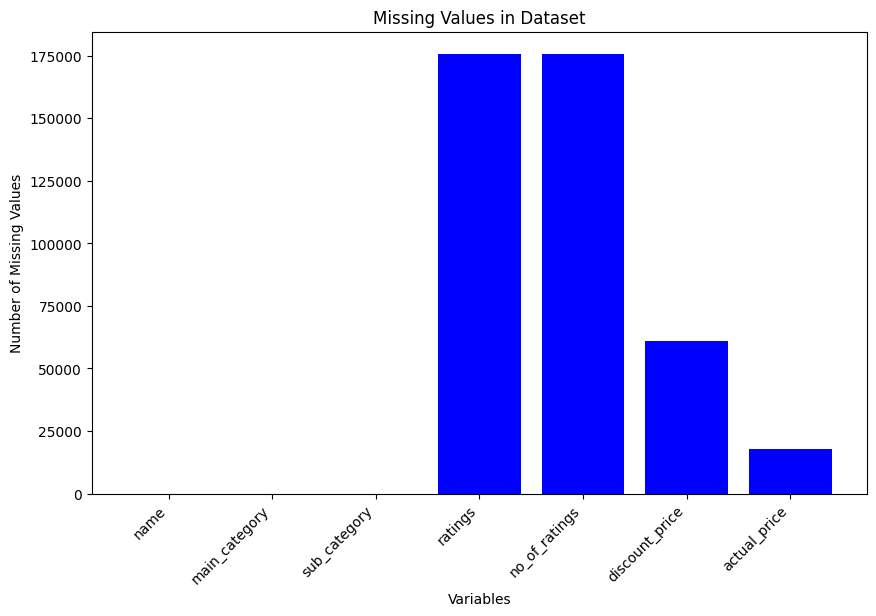

In [35]:

plt.figure(figsize=(10, 6))
plt.bar(missing_values.index, missing_values.values, color='Blue')
plt.xlabel('Variables')
plt.ylabel('Number of Missing Values')
plt.title('Missing Values in Dataset')
plt.xticks(rotation=45, ha='right')
plt.show()

In [36]:
missing_percentage = (data.isnull().sum() / len(data)) * 100
filled_percentage = 100 - missing_percentage

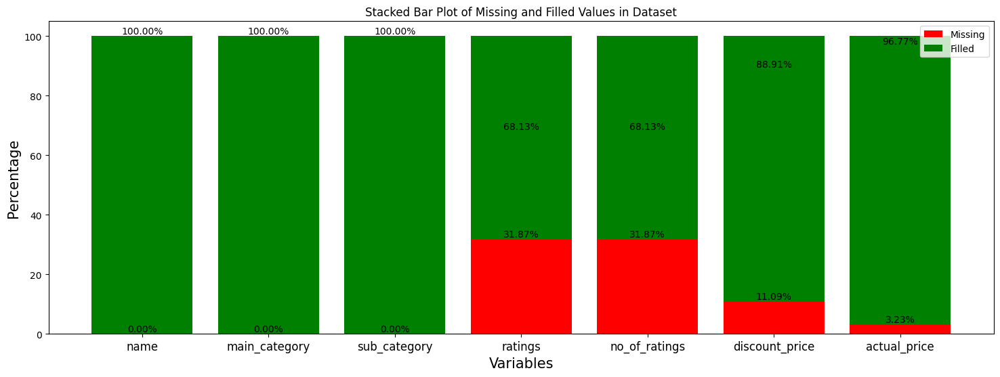

In [37]:
plt.figure(figsize=(18, 6))

bars1= plt.bar(missing_percentage.index, missing_percentage, label='Missing', color='red')
bars2= plt.bar(filled_percentage.index, filled_percentage, bottom=missing_percentage, label='Filled', color='green')

plt.xlabel('Variables',fontsize=15)
plt.ylabel('Percentage',fontsize=15)
plt.title('Stacked Bar Plot of Missing and Filled Values in Dataset')
plt.xticks(fontsize=12)
plt.legend()

for bar1, bar2 in zip(bars1, bars2):
    yval = bar1.get_height()
    plt.text(bar1.get_x() + bar1.get_width() / 2, yval, f'{yval:.2f}%', ha='center', va='bottom')
#
for bar1, bar2 in zip(bars1, bars2):
    yval = bar2.get_height()
    plt.text(bar2.get_x() + bar2.get_width() / 2, yval, f'{yval:.2f}%', ha='center', va='bottom')

plt.show()

now we conclude that no column is having 70% missing values

In [38]:
data['ratings'].unique()

array(['4.2', '4.0', '4.1', '4.3', '3.9', '3.8', '3.5', nan, '4.6', '3.3',
       '3.4', '3.7', '2.9', '5.0', '4.4', '3.6', '2.7', '4.5', '3.0',
       '3.1', '3.2', '4.8', '4.7', '2.5', '1.0', '2.6', '2.8', '2.3',
       '1.7', 'Get', '1.8', '2.4', '4.9', '2.2', '1.6', '1.9', '2.0',
       '1.4', '2.1', 'FREE', '1.2', '1.3', '1.5', '₹68.99', '₹65', '1.1',
       '₹70', '₹100', '₹99', '₹2.99'], dtype=object)

In [39]:
replace_dict = {
    np.nan:'0',
    'Get':'0',
    'FREE':'0',
    '₹68.99':'0',
    '₹65':'0',
    '₹70':'0',
    '₹100':'0',
    '₹99':'0',
    '₹2.99':'0'

}
data['ratings'] = data['ratings'].replace(replace_dict)

we successfully replace the abnormal values and NAN values to 0

In [40]:
data['ratings'].unique()

array(['4.2', '4.0', '4.1', '4.3', '3.9', '3.8', '3.5', '0', '4.6', '3.3',
       '3.4', '3.7', '2.9', '5.0', '4.4', '3.6', '2.7', '4.5', '3.0',
       '3.1', '3.2', '4.8', '4.7', '2.5', '1.0', '2.6', '2.8', '2.3',
       '1.7', '1.8', '2.4', '4.9', '2.2', '1.6', '1.9', '2.0', '1.4',
       '2.1', '1.2', '1.3', '1.5', '1.1'], dtype=object)

###NO_OF_RATINGs

In [41]:
data['no_of_ratings'].unique()

array(['2,255', '2,948', '1,206', ..., '3,329', '7,141', '4,406'],
      dtype=object)

In [42]:
data['no_of_ratings'].isna().value_counts()

,count
no_of_ratings,
False,375791
True,175794


Replacing NAN with 0

In [43]:
replace_dict = {
    np.nan :"0"
}

data['no_of_ratings']=data['no_of_ratings'].replace(replace_dict)

we have successfully replace the NAN values with 0

In [44]:

data['no_of_ratings'].isna().value_counts()

,count
no_of_ratings,
False,551585


Data has been cleaned with out null and abnormal values (replaced with 0 )

#Discount Price

In [45]:

data['discount_price'].isna().value_counts()

,count
discount_price,
False,490422
True,61163


Here we can see some null values are there, let us replace with 0 for now

In [46]:
data['discount_price'].unique()

array(['₹32,999', '₹46,490', '₹34,490', ..., '₹3,712.10', '₹1,429.60',
       '₹651.01'], dtype=object)

###Removing rupees symbol

In [47]:
data['discount_price']=data['discount_price'].str.replace('[^0-9]', '', regex=True)


Replacing NAN values with 0.0

In [48]:

data['discount_price']=data['discount_price'].replace(np.nan,0.0)

In [49]:

data['discount_price'].isna().value_counts()

,count
discount_price,
False,551585



Null values are replaced with 0 , now there is no null value

#ACTUAL PRICE

In [50]:
data['actual_price'].isna().value_counts()

,count
actual_price,
False,533772
True,17813


Here, We can observe some null value

In [51]:

data['actual_price'].unique()

array(['₹58,990', '₹75,990', '₹61,990', ..., '₹608.97', '₹4,792',
       '₹8,023.60'], dtype=object)

Removing rupees symbol

In [52]:
data['actual_price']=data['actual_price'].str.replace('[^0-9]', '', regex=True)

In [53]:
data['actual_price'].unique()


array(['58990', '75990', '61990', ..., '60897', '4792', '802360'],
      dtype=object)

Replace NAN with 0.0

In [54]:
data['actual_price']=data['actual_price'].replace(np.nan,0.0)

We successfully replace the null values with 0

In [55]:
data['actual_price'].isna().value_counts()


,count
actual_price,
False,551585



Null values are replaced with 0 , now there is no null values

In [56]:

percentage_missing = (data.isnull().sum() / len(data)) * 100
percentage_missing

,0
name,0.0
main_category,0.0
sub_category,0.0
ratings,0.0
no_of_ratings,0.0
discount_price,0.0
actual_price,0.0


In [57]:

data.isnull().sum()

,0
name,0
main_category,0
sub_category,0
ratings,0
no_of_ratings,0
discount_price,0
actual_price,0


Changing dtypes according to the data

#Ratings column

In [58]:

data['ratings']=data['ratings'].astype(float)

#No_of_Ratings Column

In [59]:
def convert_to_int(value):
    try:
        return int(value.replace(',', '').replace('Only left in stock.', '').strip())
    except (ValueError, AttributeError):
        return 0  # Return 0 for non-convertible values

# Apply the custom function to the column
data['no_of_ratings'] = data['no_of_ratings'].apply(convert_to_int)

#Discount_price column

In [60]:
data['discount_price'] = data['discount_price'].astype(float)

#Actual_price column

In [61]:
data['actual_price'] = data['actual_price'].astype(float)

In [62]:
data.drop_duplicates()

,name,main_category,sub_category,ratings,no_of_ratings,discount_price,actual_price
0,Lloyd 1.5 Ton 3 Star Inverter Split Ac (5 In 1...,appliances,Air Conditioners,4.2,2255,32999.0,58990.0
1,LG 1.5 Ton 5 Star AI DUAL Inverter Split AC (C...,appliances,Air Conditioners,4.2,2948,46490.0,75990.0
2,LG 1 Ton 4 Star Ai Dual Inverter Split Ac (Cop...,appliances,Air Conditioners,4.2,1206,34490.0,61990.0
3,LG 1.5 Ton 3 Star AI DUAL Inverter Split AC (C...,appliances,Air Conditioners,4.0,69,37990.0,68990.0
4,Carrier 1.5 Ton 3 Star Inverter Split AC (Copp...,appliances,Air Conditioners,4.1,630,34490.0,67790.0
...,...,...,...,...,...,...,...
551580,Adidas Regular Fit Men's Track Tops,sports & fitness,Yoga,3.2,9,3449.0,4599.0
551581,Redwolf Noice Toit Smort - Hoodie (Black),sports & fitness,Yoga,2.0,2,1199.0,1999.0
551582,Redwolf Schrute Farms B&B - Hoodie (Navy Blue),sports & fitness,Yoga,4.0,1,1199.0,1999.0
551583,Puma Men Shorts,sports & fitness,Yoga,4.4,37,0.0,0.0


No duplicate rows found. (becuase no change in rows)

#DATA CLEANING WAS COMPLETED

In [63]:

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 551585 entries, 0 to 551584
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   name            551585 non-null  object 
 1   main_category   551585 non-null  object 
 2   sub_category    551585 non-null  object 
 3   ratings         551585 non-null  float64
 4   no_of_ratings   551585 non-null  int64  
 5   discount_price  551585 non-null  float64
 6   actual_price    551585 non-null  float64
dtypes: float64(3), int64(1), object(3)
memory usage: 29.5+ MB


We change the dtypes and equalize the content

In [64]:

data.describe()

,ratings,no_of_ratings,discount_price,actual_price
count,551585.000000,551585.000000,5.515850e+05,5.515850e+05
mean,2.567621,563.311245,6.258484e+03,4.669279e+04
std,1.905329,7092.573805,6.774411e+04,1.333252e+07
min,0.000000,0.000000,0.000000e+00,0.000000e+00
25%,0.000000,0.000000,2.990000e+02,8.990000e+02
50%,3.500000,4.000000,5.990000e+02,1.499000e+03
75%,4.100000,49.000000,1.340000e+03,2.999000e+03
max,5.000000,589547.000000,1.065632e+07,9.900000e+09


In [65]:

missing_values= data.isnull().sum()

In [66]:

print(missing_values)

name              0
main_category     0
sub_category      0
ratings           0
no_of_ratings     0
discount_price    0
actual_price      0
dtype: int64


###Rating Column

In [67]:

data['ratings'].value_counts(normalize=True)*100

,proportion
ratings,
0.0,33.000716
4.0,6.637055
5.0,5.960097
3.9,4.912208
3.8,4.587688
4.1,4.497947
3.7,4.022952
4.2,3.936655
3.6,3.532003


Above we convert abnormal values to 0.

It has the highest percentage so that we need to change them into 3.5 which is median of all

In [68]:
data['ratings']=np.where(data['ratings']==0.0,data['ratings'].median(),data['ratings'])

In [69]:
data['ratings'].value_counts(normalize=True)*100

,proportion
ratings,
3.5,36.190614
4.0,6.637055
5.0,5.960097
3.9,4.912208
3.8,4.587688
4.1,4.497947
3.7,4.022952
4.2,3.936655
3.6,3.532003


#No_OF_RATINGS

In [74]:
data['no_of_ratings'].value_counts(normalize=True)*100

,proportion
no_of_ratings,
0,33.012138
1,7.218470
2,4.484712
3,3.282359
4,2.606307
5,2.111189
6,1.796822
7,1.556242
8,1.355548


In [75]:
data['no_of_ratings']=np.where(data['no_of_ratings']==0.0,data['no_of_ratings'].median(),data['no_of_ratings'])

In [76]:
data['no_of_ratings'].value_counts(normalize=True)*100

,proportion
no_of_ratings,
4.0,35.618445
1.0,7.218470
2.0,4.484712
3.0,3.282359
5.0,2.111189
6.0,1.796822
7.0,1.556242
8.0,1.355548
9.0,1.178241


#Discount_Price

In [77]:
data['discount_price'].value_counts(normalize=True)*100

,proportion
discount_price,
0.0,11.088590
499.0,3.308284
299.0,2.780532
399.0,2.630601
999.0,2.356844
599.0,2.132038
699.0,1.663026
349.0,1.448734
199.0,1.333430


In [78]:
data['discount_price']=np.where(data['discount_price']==0.0,data['discount_price'].median(),data['discount_price'])

In [79]:
data['discount_price'].value_counts(normalize=True)*100

,proportion
discount_price,
599.0,13.220628
499.0,3.308284
299.0,2.780532
399.0,2.630601
999.0,2.356844
699.0,1.663026
349.0,1.448734
199.0,1.333430
799.0,1.297352


#Actual Price

In [80]:
data['actual_price'].value_counts(normalize=True)*100

,proportion
actual_price,
9.990000e+02,8.842517
1.499000e+03,6.639956
1.999000e+03,4.676523
4.990000e+02,2.611746
1.299000e+03,2.550468
2.999000e+03,2.508226
7.990000e+02,2.386214
5.990000e+02,2.356119
1.599000e+03,2.329831


In [81]:
data['actual_price']=np.where(data['actual_price']==0.0,data['actual_price'].median(),data['actual_price'])

In [82]:
data['actual_price'].value_counts(normalize=True)*100

,proportion
actual_price,
9.990000e+02,8.842517
1.499000e+03,6.639956
1.999000e+03,4.676523
4.990000e+02,2.611746
1.299000e+03,2.550468
2.999000e+03,2.508226
7.990000e+02,2.386214
5.990000e+02,2.356119
1.599000e+03,2.329831


#ADDING EXTRA COLUMNS FOR BETTER INSIGHTS

In [83]:
data.columns

Index(['name', 'main_category', 'sub_category', 'ratings', 'no_of_ratings',
       'discount_price', 'actual_price'],
      dtype='object')

Sales percentage

Discount Amount

Rating level

Discount percentage

#Sales Percentage

In [84]:
data['sales_per'] = ((data['discount_price']/data['actual_price'])*100).round(2)

#Discount Offered

In [85]:
data['Discount_Offered'] = data['actual_price']-data['discount_price']

#Rating level

In [86]:
conditions = [
    (data['ratings'] > 4.0),
    (data['ratings'] > 3.2),
]

choices = ['Top rated', 'Average']

data['Rating_level'] = np.select(conditions, choices, default='Low')

#Discount percentage

In [87]:

data['Discount_per'] = 1- data['discount_price']/data['actual_price']

In [88]:
data['discount_price'].max()

10656317.0

In [89]:

data['discount_price'].min()

8.0

#Brand Name

In [90]:

data['Brand_Name'] = data['name'].str.split(" ").str[0]

In [91]:
columns = ['name','Brand_Name', 'main_category', 'sub_category','actual_price','discount_price',
           'Discount_Offered', 'Discount_per' ,'sales_per',
           'ratings', 'Rating_level','no_of_ratings' ]
data=data[columns]

In [92]:

data.select_dtypes(include=['object','category'])

,name,Brand_Name,main_category,sub_category,Rating_level
0,Lloyd 1.5 Ton 3 Star Inverter Split Ac (5 In 1...,Lloyd,appliances,Air Conditioners,Top rated
1,LG 1.5 Ton 5 Star AI DUAL Inverter Split AC (C...,LG,appliances,Air Conditioners,Top rated
2,LG 1 Ton 4 Star Ai Dual Inverter Split Ac (Cop...,LG,appliances,Air Conditioners,Top rated
3,LG 1.5 Ton 3 Star AI DUAL Inverter Split AC (C...,LG,appliances,Air Conditioners,Average
4,Carrier 1.5 Ton 3 Star Inverter Split AC (Copp...,Carrier,appliances,Air Conditioners,Top rated
...,...,...,...,...,...
551580,Adidas Regular Fit Men's Track Tops,Adidas,sports & fitness,Yoga,Low
551581,Redwolf Noice Toit Smort - Hoodie (Black),Redwolf,sports & fitness,Yoga,Low
551582,Redwolf Schrute Farms B&B - Hoodie (Navy Blue),Redwolf,sports & fitness,Yoga,Average
551583,Puma Men Shorts,Puma,sports & fitness,Yoga,Top rated


In [93]:
data.columns

Index(['name', 'Brand_Name', 'main_category', 'sub_category', 'actual_price',
       'discount_price', 'Discount_Offered', 'Discount_per', 'sales_per',
       'ratings', 'Rating_level', 'no_of_ratings'],
      dtype='object')

In [94]:

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 551585 entries, 0 to 551584
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   name              551585 non-null  object 
 1   Brand_Name        551585 non-null  object 
 2   main_category     551585 non-null  object 
 3   sub_category      551585 non-null  object 
 4   actual_price      551585 non-null  float64
 5   discount_price    551585 non-null  float64
 6   Discount_Offered  551585 non-null  float64
 7   Discount_per      551585 non-null  float64
 8   sales_per         551585 non-null  float64
 9   ratings           551585 non-null  float64
 10  Rating_level      551585 non-null  object 
 11  no_of_ratings     551585 non-null  float64
dtypes: float64(7), object(5)
memory usage: 50.5+ MB


<Axes: title={'center': 'UNIQUE COUNTS'}>

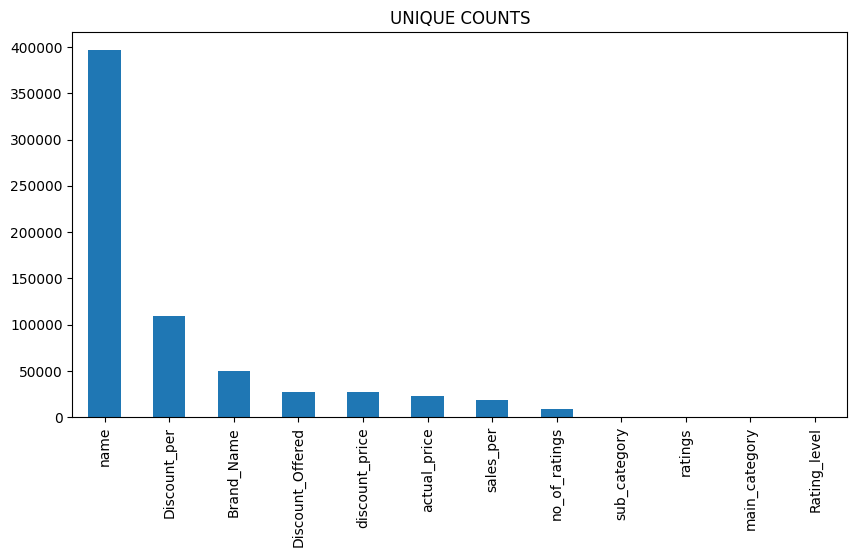

In [95]:
data.nunique().sort_values(ascending=False).plot(kind='bar',figsize=(10,5),title = 'UNIQUE COUNTS')

#OUTLIERS DETECTION

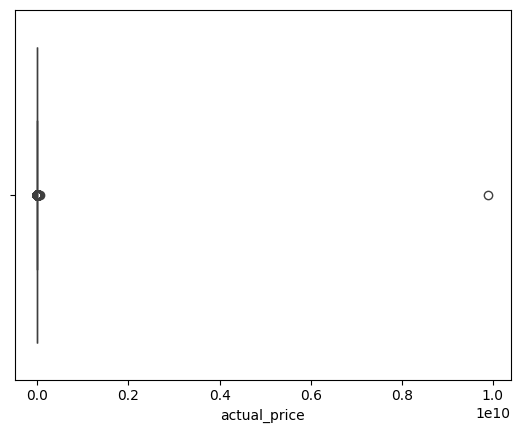

In [96]:

sb.boxplot(data=data,x='actual_price')
plt.show()

In [97]:
max(data['actual_price'])

9899999999.0

In [98]:

min(data['actual_price'])

4.0

In [99]:
x= np.quantile(data['actual_price'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)

Q1:  999.0
Q3:  2999.0


In [100]:

IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

In [101]:
data['actual_price']=np.where(data['actual_price']>uw,uw,data['actual_price'])

In [102]:
data['actual_price']=np.where(data['actual_price']<lw,lw,data['actual_price'])

In [103]:
max(data['actual_price'])

5999.0

<Axes: xlabel='actual_price'>

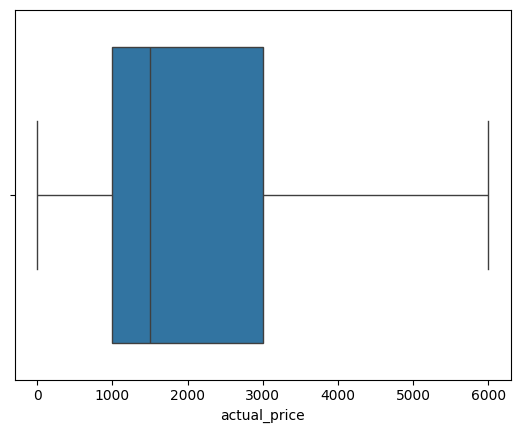

In [104]:
sb.boxplot(data=data,x='actual_price')

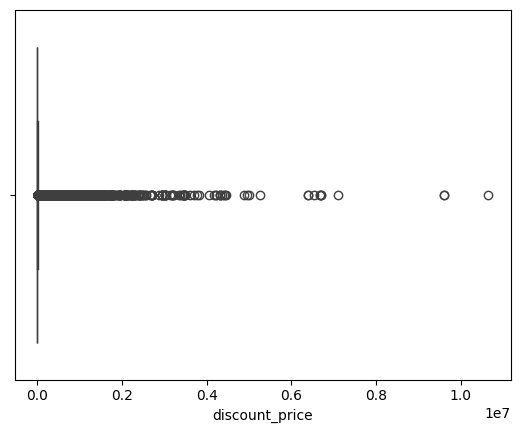

In [105]:

sb.boxplot(data=data,x='discount_price')
plt.show()

In [106]:
x= np.quantile(data['discount_price'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)
IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

Q1:  405.0
Q3:  1340.0


In [107]:

data['discount_price']=np.where(data['discount_price']>uw,uw,data['discount_price'])

In [108]:
data['discount_price']=np.where(data['discount_price']<lw,lw,data['discount_price'])

<Axes: xlabel='discount_price'>

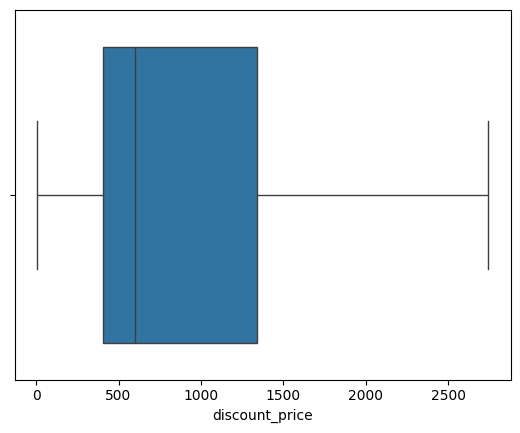

In [109]:
sb.boxplot(data=data,x='discount_price')

In [110]:
max(data['discount_price'])

2742.5

In [111]:

min(data['discount_price'])

8.0

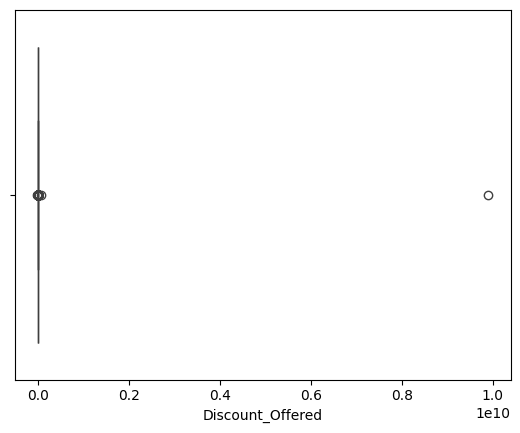

In [112]:
sb.boxplot(data=data,x='Discount_Offered')
plt.show()

In [113]:

x= np.quantile(data['Discount_Offered'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)
IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

Q1:  375.0
Q3:  1665.0


In [114]:
data['Discount_Offered']=np.where(data['Discount_Offered']>uw,uw,data['Discount_Offered'])

In [115]:
data['Discount_Offered']=np.where(data['Discount_Offered']<lw,lw,data['Discount_Offered'])

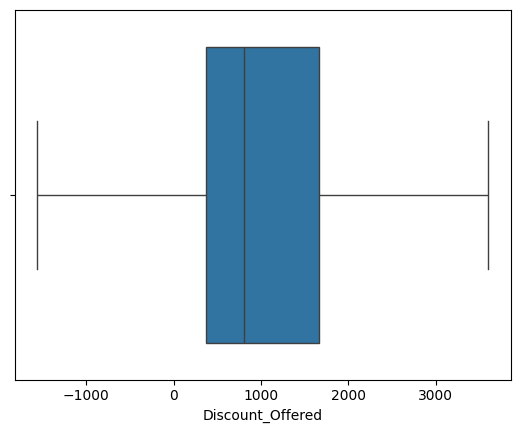

In [116]:

sb.boxplot(data=data,x='Discount_Offered')
plt.show()

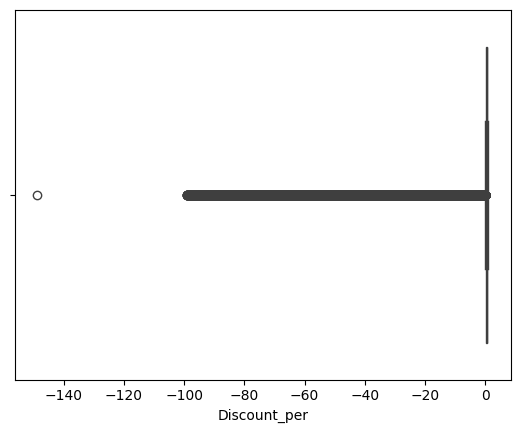

In [117]:
sb.boxplot(data=data,x='Discount_per')
plt.show()

In [118]:
x= np.quantile(data['Discount_per'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)
IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

Q1:  0.3337041156840934
Q3:  0.6653326663331666


In [119]:
data['Discount_per']=np.where(data['Discount_per']>uw,uw,data['Discount_per'])

In [120]:
data['Discount_per']=np.where(data['Discount_per']<lw,lw,data['Discount_per'])

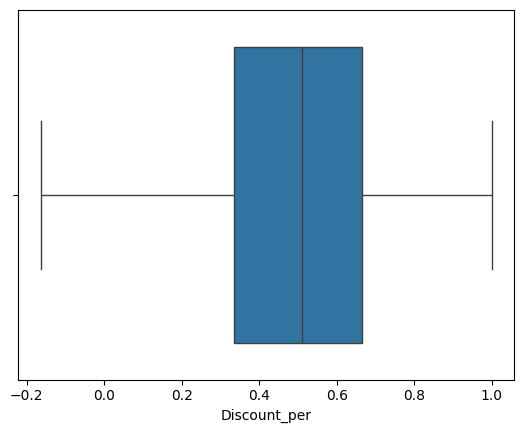

In [121]:
sb.boxplot(data=data,x='Discount_per')
plt.show()

In [122]:
data.columns

Index(['name', 'Brand_Name', 'main_category', 'sub_category', 'actual_price',
       'discount_price', 'Discount_Offered', 'Discount_per', 'sales_per',
       'ratings', 'Rating_level', 'no_of_ratings'],
      dtype='object')

In [123]:

data['sales_per'].unique()

array([  55.94,   61.18,   55.64, ..., 7425.69, 3972.21, 2713.67])

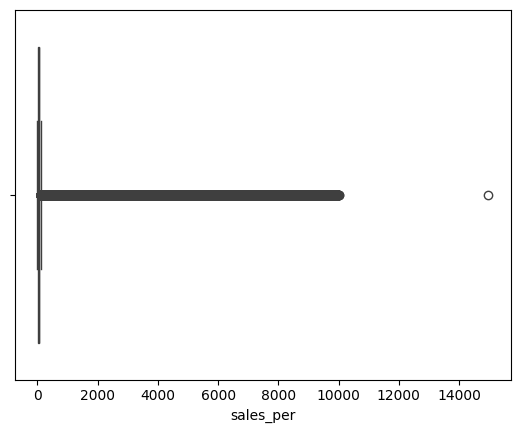

In [124]:
sb.boxplot(data=data,x='sales_per')
plt.show()

In [125]:

x= np.quantile(data['sales_per'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)
IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

Q1:  33.47
Q3:  66.63


In [126]:

data['sales_per']=np.where(data['sales_per']>uw,uw,data['sales_per'])
data['sales_per']=np.where(data['sales_per']<lw,lw,data['sales_per'])

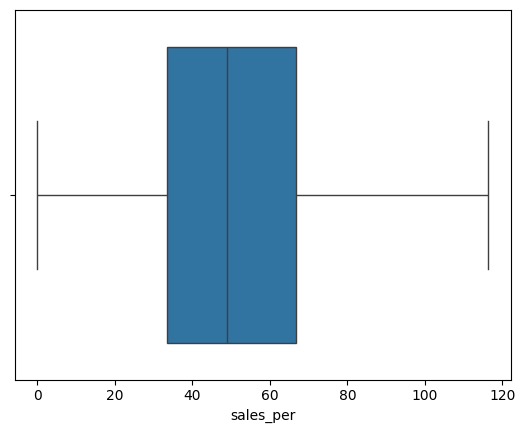

In [127]:

sb.boxplot(data=data,x='sales_per')
plt.show()

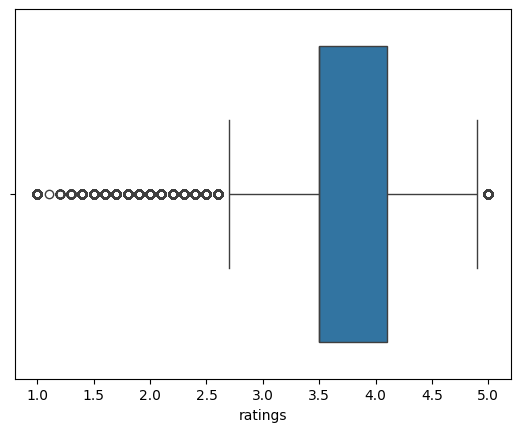

In [128]:
sb.boxplot(data=data, x='ratings')
plt.show()

In [129]:

x= np.quantile(data['ratings'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)
IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

Q1:  3.5
Q3:  4.1


In [130]:
data['ratings']=np.where(data['ratings']>uw,uw,data['ratings'])
data['ratings']=np.where(data['ratings']<lw,lw,data['ratings'])

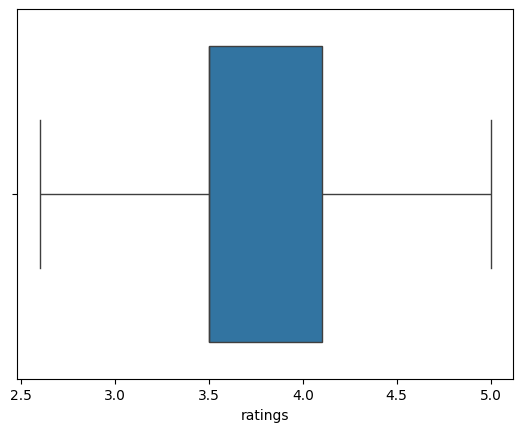

In [131]:
sb.boxplot(data=data, x='ratings')
plt.show()

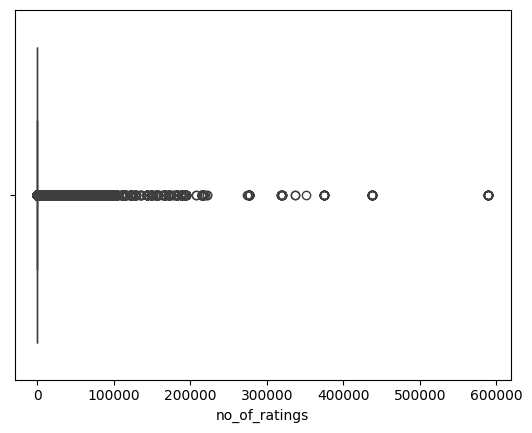

In [132]:
sb.boxplot(data=data, x='no_of_ratings')
plt.show()

In [133]:

x= np.quantile(data['no_of_ratings'],(0.25,0.75))
Q3=x[1]
Q1=x[0]
print("Q1: ",Q1)
print("Q3: ",Q3)
IQR = Q3-Q1
uw= Q3+ 1.5*IQR
lw =Q1-1.5 * IQR

Q1:  4.0
Q3:  49.0


In [134]:
data['no_of_ratings']=np.where(data['no_of_ratings']>uw,uw,data['no_of_ratings'])
data['no_of_ratings']=np.where(data['no_of_ratings']<lw,lw,data['no_of_ratings'])

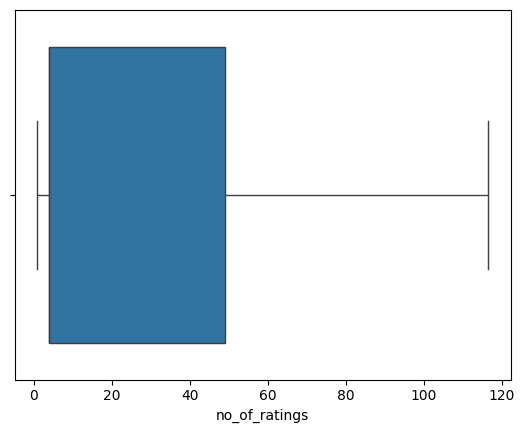

In [135]:
sb.boxplot(data=data, x='no_of_ratings')
plt.show()

In [136]:
data.describe()

,actual_price,discount_price,Discount_Offered,Discount_per,sales_per,ratings,no_of_ratings
count,551585.000000,551585.000000,551585.000000,551585.000000,551585.000000,551585.000000,551585.000000
mean,2273.238997,1013.372030,1148.494404,0.482513,51.748500,3.755464,32.351416
std,1816.405651,842.392544,1165.108504,0.255003,25.499937,0.537424,44.047834
min,4.000000,8.000000,-1560.000000,-0.163739,0.000000,2.600000,1.000000
25%,999.000000,405.000000,375.000000,0.333704,33.470000,3.500000,4.000000
50%,1499.000000,599.000000,802.000000,0.510308,48.970000,3.500000,4.000000
75%,2999.000000,1340.000000,1665.000000,0.665333,66.630000,4.100000,49.000000
max,5999.000000,2742.500000,3600.000000,1.000000,116.370000,5.000000,116.500000


#UNI-VARiATE ANALYSIS OF BRAND_NAME

##What are the top 10 brands with respective to their product counts?

<ipython-input-137-36c4b5cc6804>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sb.barplot(x=top_brands.index, y=top_brands.values, palette='plasma')


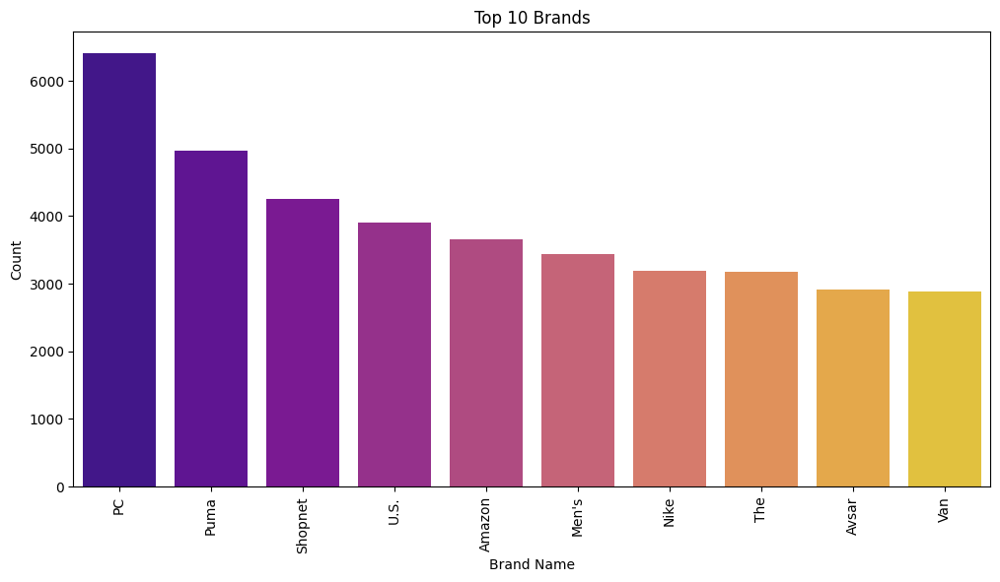

In [137]:
brand_counts = data['Brand_Name'].value_counts()
top_brands = brand_counts.head(10)  # Display top 10 brands
plt.figure(figsize=(12, 6))
sb.barplot(x=top_brands.index, y=top_brands.values, palette='plasma')
plt.xticks(rotation=90)
plt.xlabel('Brand Name')
plt.ylabel('Count')
plt.title('Top 10 Brands')
plt.show()

#which company products are buying more?

###Ans:- PC Company products are buying more

<ipython-input-138-66527c5e6440>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sb.barplot(x=low_brands.index, y=low_brands.values, palette='plasma')


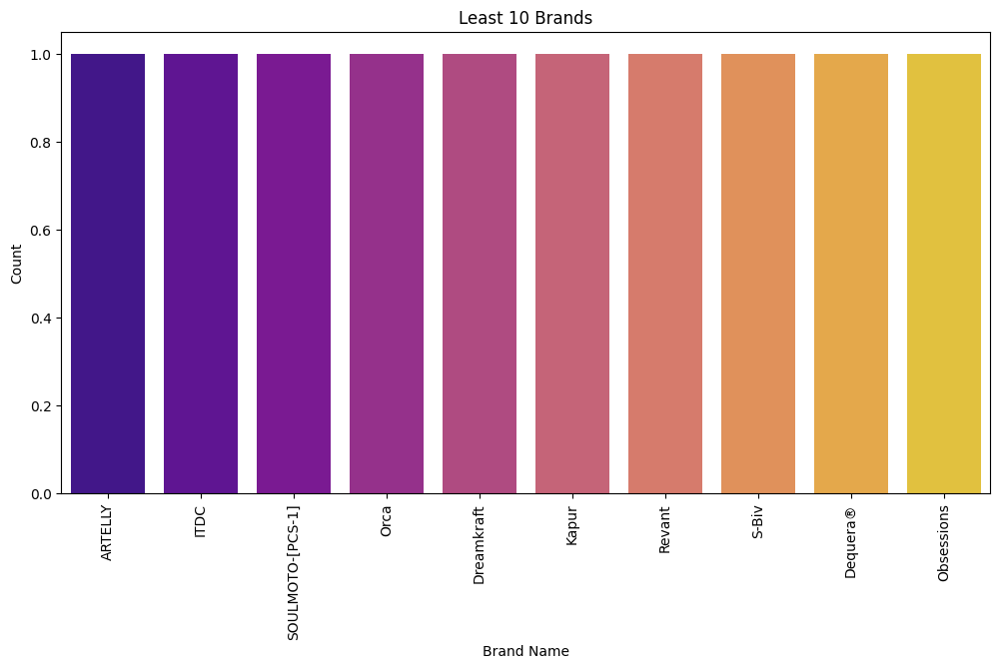

In [138]:
brand_counts = data['Brand_Name'].value_counts()
low_brands = brand_counts.tail(10)  # Display top 10 brands
plt.figure(figsize=(12, 6))
sb.barplot(x=low_brands.index, y=low_brands.values, palette='plasma')
plt.xticks(rotation=90)
plt.xlabel('Brand Name')
plt.ylabel('Count')
plt.title('Least 10 Brands')
plt.show()

#What are the main categories of the products in terms of their counts?

In [139]:
data['main_category'].value_counts().reset_index()

,main_category,count
0,accessories,116141
1,men's clothing,76656
2,women's clothing,76512
3,"tv, audio & cameras",68659
4,men's shoes,57456
5,appliances,33096
6,stores,32903
7,home & kitchen,14568
8,kids' fashion,13488
9,sports & fitness,12648


In [140]:
data['main_category'].unique()

array(['appliances', 'car & motorbike', 'tv, audio & cameras',
       'sports & fitness', 'grocery & gourmet foods', 'home & kitchen',
       'pet supplies', 'stores', 'toys & baby products', "kids' fashion",
       'bags & luggage', 'accessories', "women's shoes",
       'beauty & health', "men's shoes", "women's clothing",
       'industrial supplies', "men's clothing", 'music',
       'home, kitchen, pets'], dtype=object)

In [141]:
data['main_category'].unique()

array(['appliances', 'car & motorbike', 'tv, audio & cameras',
       'sports & fitness', 'grocery & gourmet foods', 'home & kitchen',
       'pet supplies', 'stores', 'toys & baby products', "kids' fashion",
       'bags & luggage', 'accessories', "women's shoes",
       'beauty & health', "men's shoes", "women's clothing",
       'industrial supplies', "men's clothing", 'music',
       'home, kitchen, pets'], dtype=object)

In [142]:
main_cat=data['main_category'].value_counts().reset_index().head(10)
main_cat

,main_category,count
0,accessories,116141
1,men's clothing,76656
2,women's clothing,76512
3,"tv, audio & cameras",68659
4,men's shoes,57456
5,appliances,33096
6,stores,32903
7,home & kitchen,14568
8,kids' fashion,13488
9,sports & fitness,12648


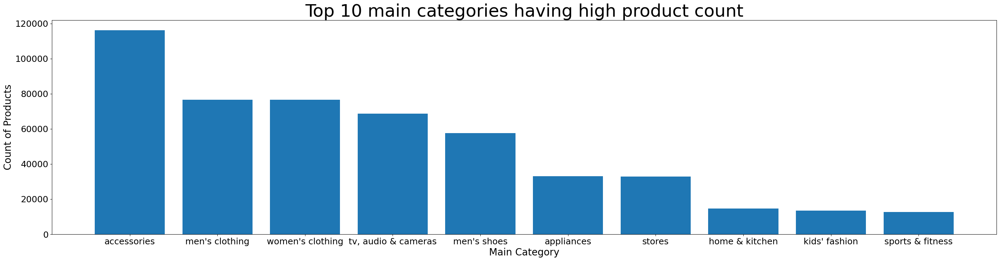

In [143]:
plt.figure(figsize=(35,8))
plt.bar(main_cat['main_category'],main_cat['count'])
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.title("Top 10 main categories having high product count",fontsize=36)
plt.xlabel('Main Category', fontsize = 20 )
plt.ylabel('Count of Products',fontsize=20)
plt.show()

#What are the sub-categories of the products with respect to their product count?

In [144]:
data['sub_category'].value_counts().reset_index()

,sub_category,count
0,Shirts,19200
1,Sports Shoes,19200
2,Jeans,19200
3,Western Wear,19200
4,Men's Fashion,19200
...,...,...
107,STEM Toys Store,48
108,Fashion Sales & Deals,44
109,Toys Gifting Store,24
110,International Toy Store,24


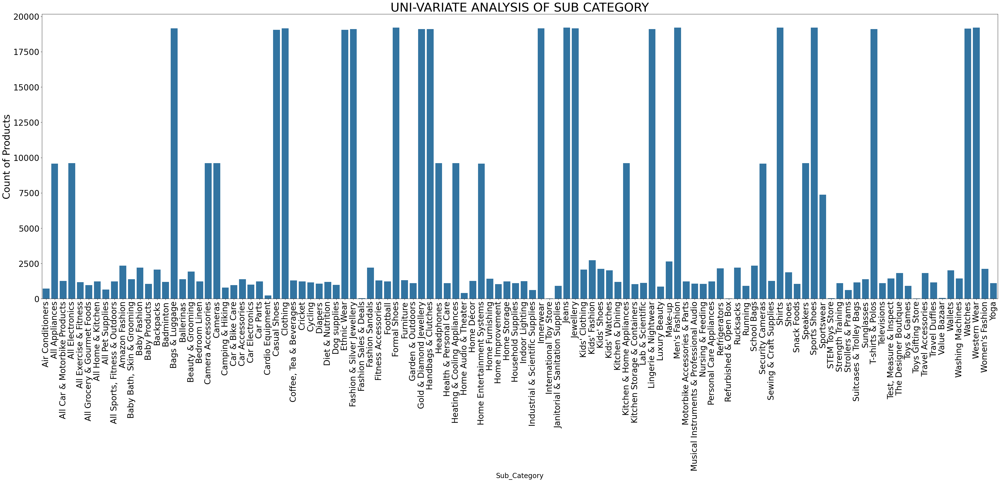

In [145]:
plt.figure(figsize=(50,15))
sb.countplot(data=data,x='sub_category')
plt.xticks(rotation=90,fontsize=24)
plt.yticks(fontsize=24)
plt.xlabel('Sub_Category',fontsize=20)
plt.ylabel('Count of Products', fontsize=28)
plt.title("UNI-VARIATE ANALYSIS OF SUB CATEGORY",fontsize=36)
plt.show()

##Top 10 sub categories

In [146]:

sub_cat=data['sub_category'].value_counts().reset_index().head(10)
sub_cat

,sub_category,count
0,Shirts,19200
1,Sports Shoes,19200
2,Jeans,19200
3,Western Wear,19200
4,Men's Fashion,19200
5,Formal Shoes,19200
6,Innerwear,19152
7,Jewellery,19152
8,Clothing,19152
9,Bags & Luggage,19152


In [147]:
sub_cat.sub_category.values

array(['Shirts', 'Sports Shoes', 'Jeans', 'Western Wear', "Men's Fashion",
       'Formal Shoes', 'Innerwear', 'Jewellery', 'Clothing',
       'Bags & Luggage'], dtype=object)

#What are the top 10 sub categories with respect to product count?


<ipython-input-148-1217bac36fc6>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sb.barplot(x=top_sub_categories.index, y=top_sub_categories.values, palette='tab20')


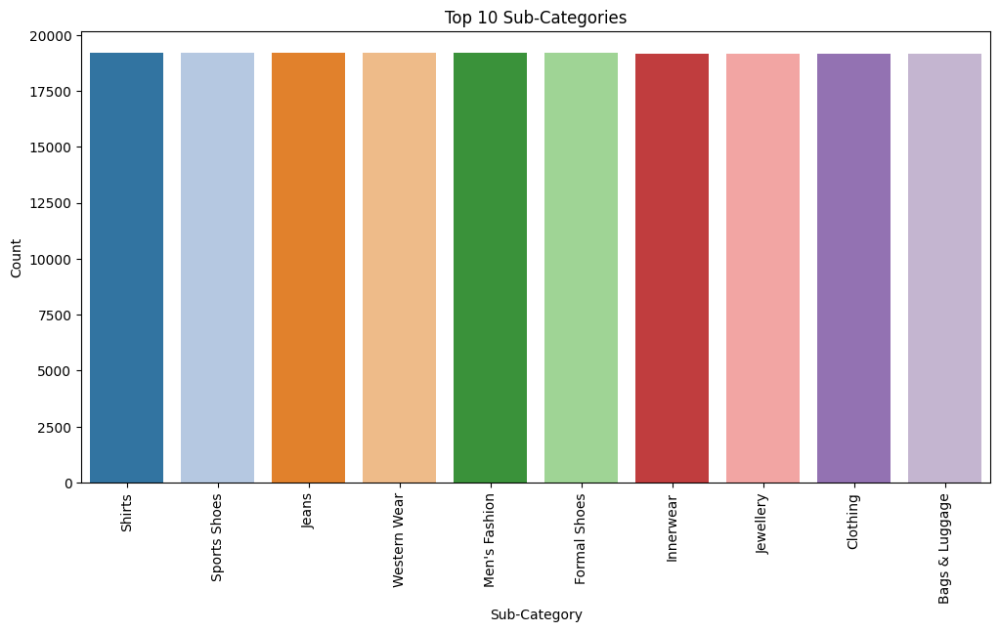

In [148]:

# Column: 'sub_category' - Sub-Category
# Univariate analysis for categorical data
sub_category_counts = data['sub_category'].value_counts()
top_sub_categories = sub_category_counts.head(10)  # Display top 10 sub-categories
plt.figure(figsize=(12, 6))
sb.barplot(x=top_sub_categories.index, y=top_sub_categories.values, palette='tab20')
plt.xticks(rotation=90)
plt.xlabel('Sub-Category')
plt.ylabel('Count')
plt.title('Top 10 Sub-Categories')
plt.show()

##Bottom 10 sub categories

In [149]:

sub_cat2=data['sub_category'].value_counts().reset_index().tail(10)
sub_cat2

,sub_category,count
102,Strollers & Prams,624
103,Industrial & Scientific Supplies,624
104,Home Audio & Theater,403
105,Cardio Equipment,240
106,Value Bazaar,66
107,STEM Toys Store,48
108,Fashion Sales & Deals,44
109,Toys Gifting Store,24
110,International Toy Store,24
111,Refurbished & Open Box,24


#What are the bottom 10 sub categories with respect to product count?

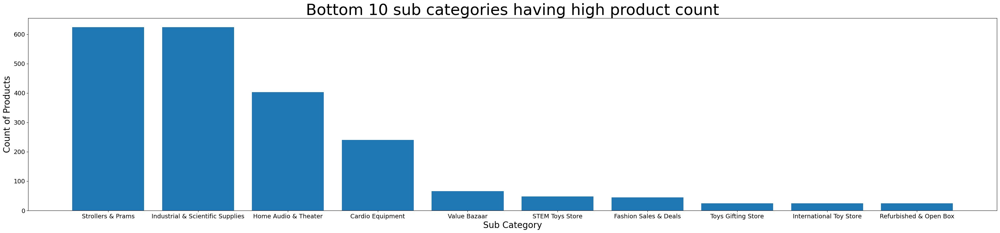

In [150]:

plt.figure(figsize=(40,8))
plt.bar(sub_cat2['sub_category'],sub_cat2['count'])
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.title("Bottom 10 sub categories having high product count",fontsize=36)
plt.xlabel('Sub Category', fontsize = 20 )
plt.ylabel('Count of Products',fontsize=20)
plt.show()

In [151]:
data.columns

Index(['name', 'Brand_Name', 'main_category', 'sub_category', 'actual_price',
       'discount_price', 'Discount_Offered', 'Discount_per', 'sales_per',
       'ratings', 'Rating_level', 'no_of_ratings'],
      dtype='object')

<ipython-input-152-aca83ec4b325>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sb.barplot(x=top_names.index, y=top_names.values, palette='viridis')


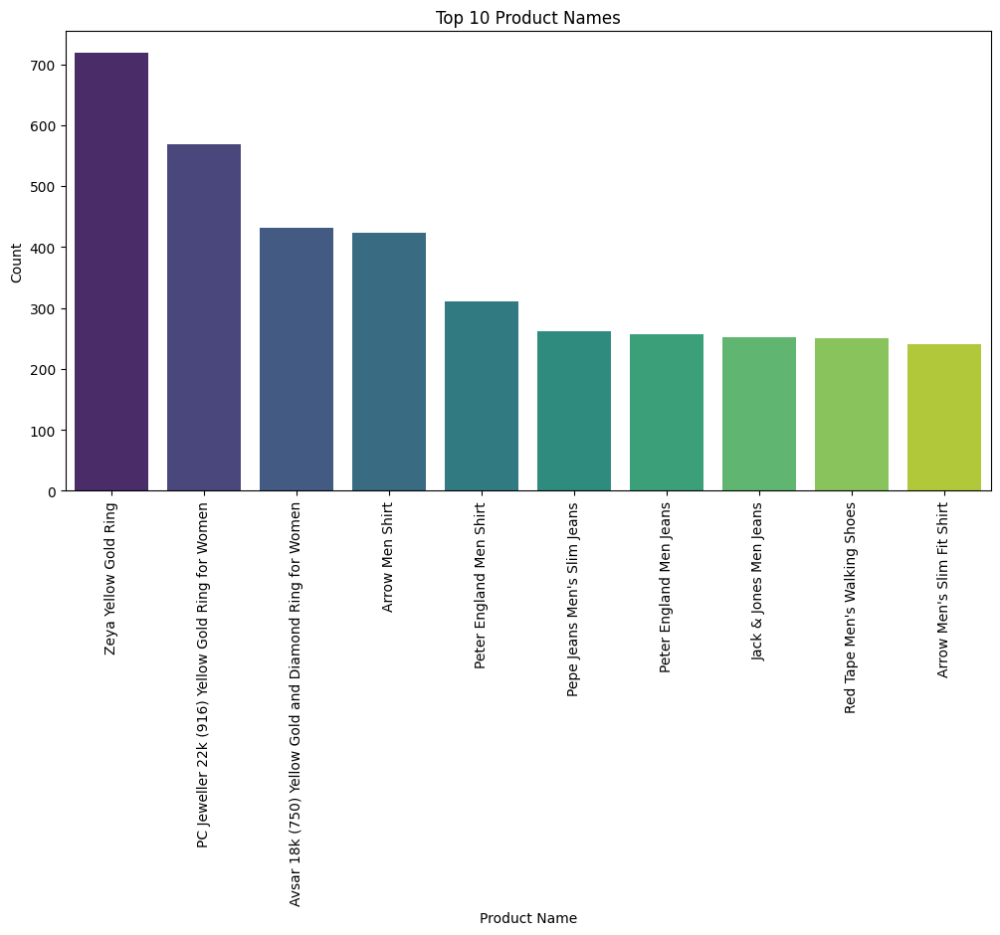

In [152]:
name_counts = data['name'].value_counts()
top_names = name_counts.head(10)  # Display top 10 product names
plt.figure(figsize=(12, 6))
sb.barplot(x=top_names.index, y=top_names.values, palette='viridis')
plt.xticks(rotation=90)
plt.xlabel('Product Name')
plt.ylabel('Count')
plt.title('Top 10 Product Names')
plt.show()

In [153]:
top_names.index

Index(['Zeya Yellow Gold Ring',
       'PC Jeweller 22k (916) Yellow Gold Ring for Women',
       'Avsar 18k (750) Yellow Gold and Diamond Ring for Women',
       'Arrow Men Shirt', 'Peter England Men Shirt',
       'Pepe Jeans Men's Slim Jeans', 'Peter England Men Jeans',
       'Jack & Jones Men Jeans', 'Red Tape Men's Walking Shoes',
       'Arrow Men's Slim Fit Shirt'],
      dtype='object', name='name')

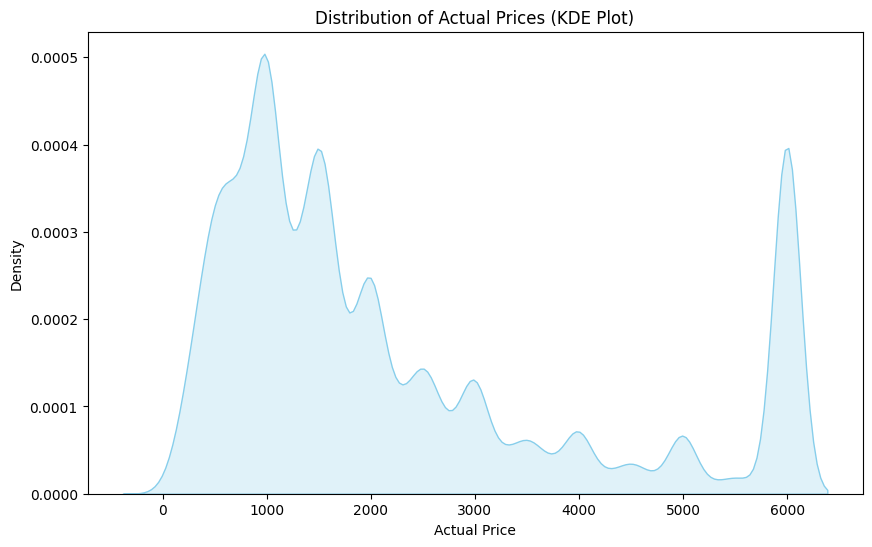

In [154]:
# Column: 'actual_price' - Actual Price
# Univariate analysis for numerical data (KDE plot)
plt.figure(figsize=(10, 6))
sb.kdeplot(data['actual_price'], color='skyblue', fill=True)
plt.xlabel('Actual Price')
plt.ylabel('Density')
plt.title('Distribution of Actual Prices (KDE Plot)')
plt.show()

The KDE plot of the ‘actual_price’ column shows that the distribution of actual prices appears to be bimodal, with two peaks around 1000 and 2500. This suggests that there are two groups in the data with different price ranges. The density is highest at these two peaks, indicating that most of the prices are around these values. The density decreases as the price increases or decreases from these values, indicating fewer data points in those ranges. This could imply that items priced around 1000 and 2500 are more common.

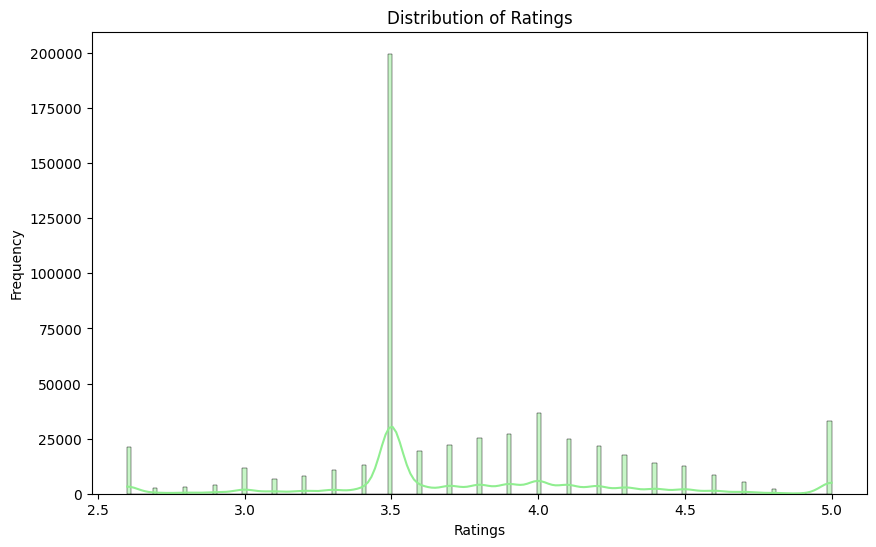

In [155]:
# Column: 'ratings' - Ratings (Numerical)
# Univariate analysis for numerical data (histogram)
plt.figure(figsize=(10, 6))
sb.histplot(data['ratings'], kde=True, color='lightgreen')
plt.xlabel('Ratings')
plt.ylabel('Frequency')
plt.title('Distribution of Ratings')
plt.show()

The histogram of the ratings column apperas that distribution be bimodal



In [156]:
data['ratings'].unique()

array([4.2, 4. , 4.1, 4.3, 3.9, 3.8, 3.5, 4.6, 3.3, 3.4, 3.7, 2.9, 5. ,
       4.4, 3.6, 2.7, 4.5, 3. , 3.1, 3.2, 4.8, 4.7, 2.6, 2.8, 4.9])

<ipython-input-157-5bc338dcaabb>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sb.barplot(x=rating_level_counts.index, y=rating_level_counts.values, palette='Pastel1')


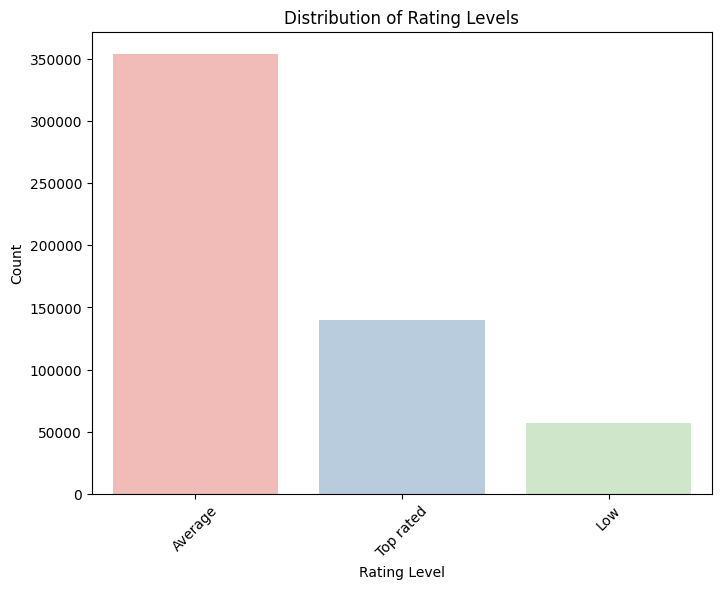

In [157]:
rating_level_counts = data['Rating_level'].value_counts()
plt.figure(figsize=(8, 6))
sb.barplot(x=rating_level_counts.index, y=rating_level_counts.values, palette='Pastel1')
plt.xticks(rotation=45)
plt.xlabel('Rating Level')
plt.ylabel('Count')
plt.title('Distribution of Rating Levels')
plt.show()

#BI-VARIATE ANALYSIS

###Most Popular Products:

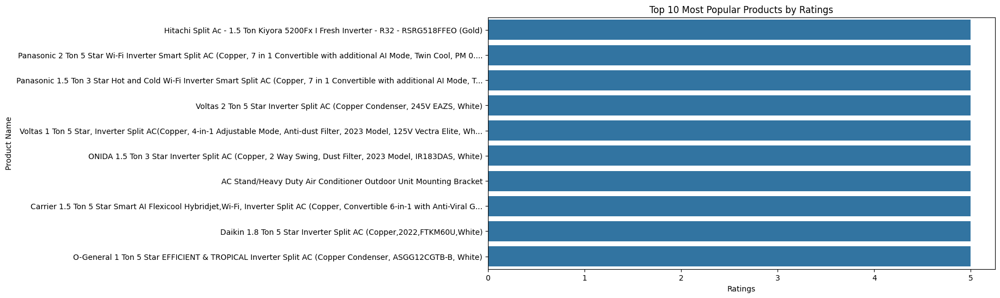

In [158]:

top_rated_products = data.nlargest(10, 'ratings')
plt.figure(figsize=(12, 6))
sb.barplot(data=top_rated_products, x='ratings', y='name')
plt.title('Top 10 Most Popular Products by Ratings')
plt.xlabel('Ratings')
plt.ylabel('Product Name')
plt.show()

In [159]:
top_rated_products.name.values

array(['Hitachi Split Ac - 1.5 Ton Kiyora 5200Fx I Fresh Inverter - R32 - RSRG518FFEO (Gold)',
       'Panasonic 2 Ton 5 Star Wi-Fi Inverter Smart Split AC (Copper, 7 in 1 Convertible with additional AI Mode, Twin Cool, PM 0....',
       'Panasonic 1.5 Ton 3 Star Hot and Cold Wi-Fi Inverter Smart Split AC (Copper, 7 in 1 Convertible with additional AI Mode, T...',
       'Voltas 2 Ton 5 Star Inverter Split AC (Copper Condenser, 245V EAZS, White)',
       'Voltas 1 Ton 5 Star, Inverter Split AC(Copper, 4-in-1 Adjustable Mode, Anti-dust Filter, 2023 Model, 125V Vectra Elite, Wh...',
       'ONIDA 1.5 Ton 3 Star Inverter Split AC (Copper, 2 Way Swing, Dust Filter, 2023 Model, IR183DAS, White)',
       'AC Stand/Heavy Duty Air Conditioner Outdoor Unit Mounting Bracket',
       'Carrier 1.5 Ton 5 Star Smart AI Flexicool Hybridjet,Wi-Fi, Inverter Split AC (Copper, Convertible 6-in-1 with Anti-Viral G...',
       'Daikin 1.8 Ton 5 Star Inverter Split AC (Copper,2022,FTKM60U,White)',
       'O

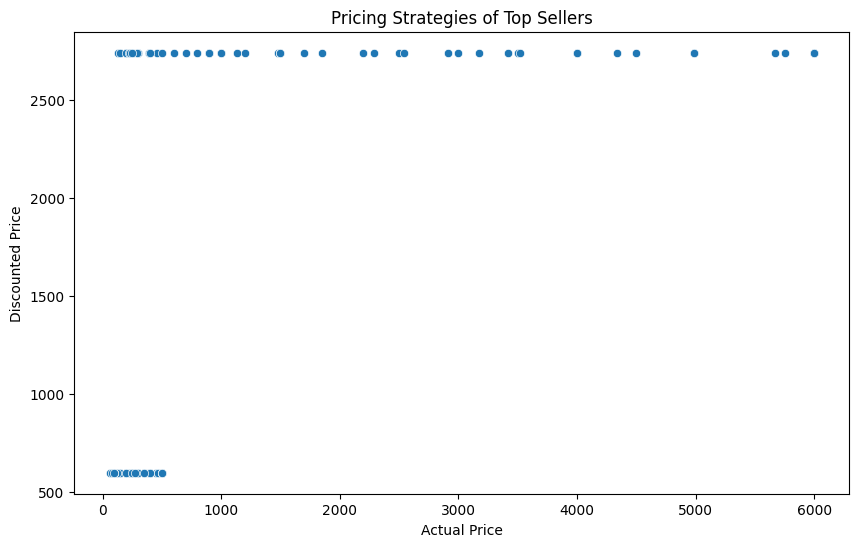

In [160]:
# Create a scatter plot to compare actual_price and discount_price for top-selling products
top_selling_products = data.nlargest(100, 'sales_per')  # Assuming you consider the top 100 products as top sellers
plt.figure(figsize=(10, 6))
sb.scatterplot(data=top_selling_products, x='actual_price', y='discount_price')
plt.title('Pricing Strategies of Top Sellers')
plt.xlabel('Actual Price')
plt.ylabel('Discounted Price')
plt.show()
# Explain the pricing strategies you observe among top sellers.

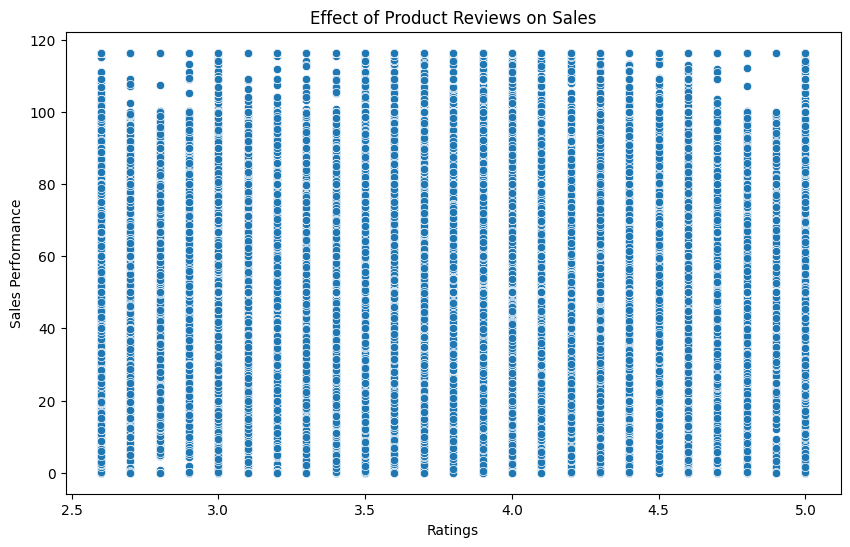

In [161]:
# Create a scatter plot to analyze the correlation between ratings and sales_per
plt.figure(figsize=(10, 6))
sb.scatterplot(data=data, x='ratings', y='sales_per')
plt.title('Effect of Product Reviews on Sales')
plt.xlabel('Ratings')
plt.ylabel('Sales Performance')
plt.show()
# Explain the relationship between ratings and sales performance.

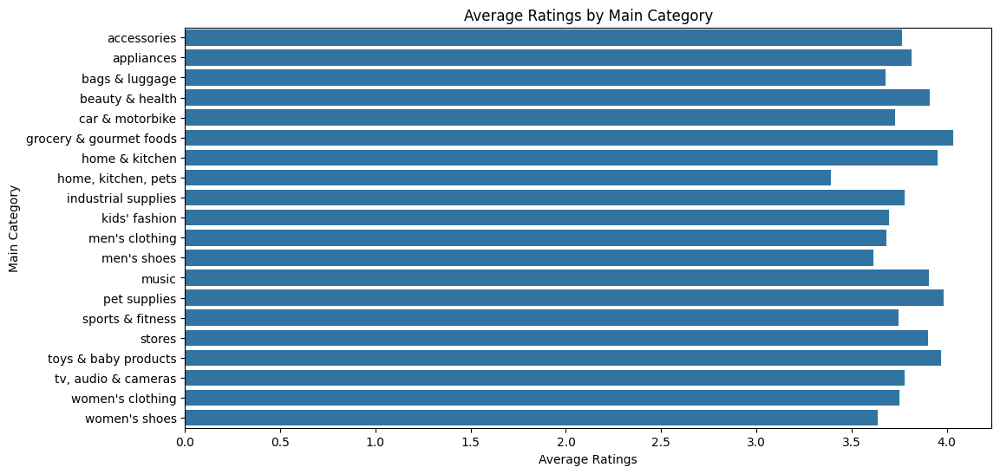

In [162]:

# Create a bar chart to show the average ratings by main_category
avg_ratings_by_category = data.groupby('main_category')['ratings'].mean().reset_index()
plt.figure(figsize=(12, 6))
sb.barplot(data=avg_ratings_by_category, x='ratings', y='main_category')
plt.title('Average Ratings by Main Category')
plt.xlabel('Average Ratings')
plt.ylabel('Main Category')
plt.show()
# Explain which main categories have high average ratings.

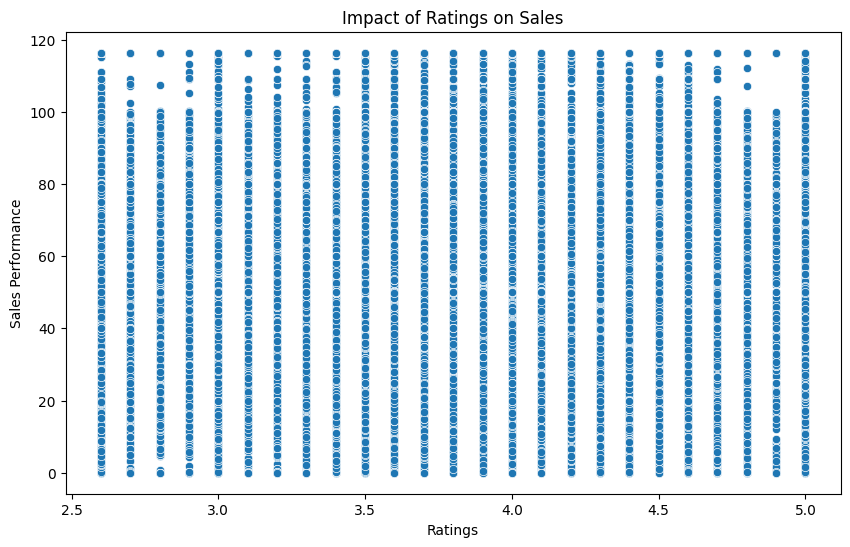

In [163]:
 #Create a scatter plot to analyze the correlation between ratings and sales_per
plt.figure(figsize=(10, 6))
sb.scatterplot(data=data, x='ratings', y='sales_per')
plt.title('Impact of Ratings on Sales')
plt.xlabel('Ratings')
plt.ylabel('Sales Performance')
plt.show()
# Explain how ratings impact the sales performance of products.

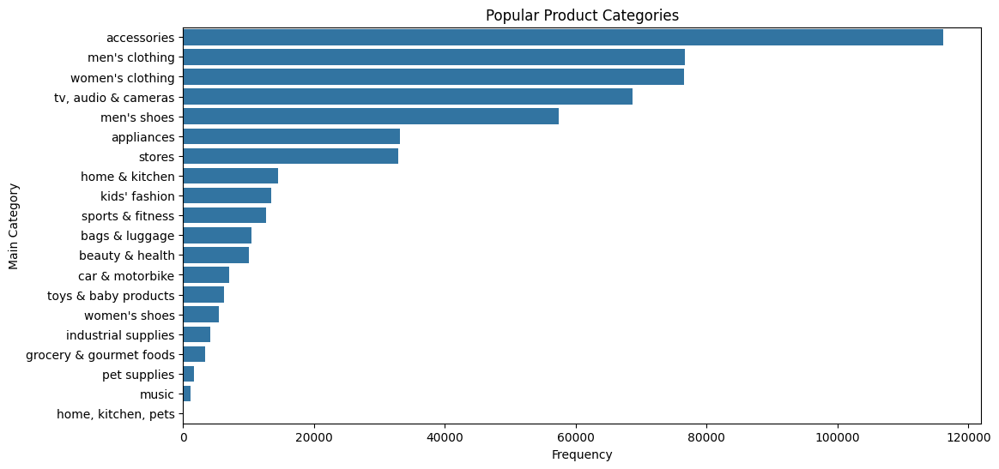

In [164]:
# Create a count plot to show the frequency of each main_category
plt.figure(figsize=(12, 6))
sb.countplot(data=data, y='main_category', order=data['main_category'].value_counts().index)
plt.title('Popular Product Categories')
plt.xlabel('Frequency')
plt.ylabel('Main Category')
plt.show()
# Explain which main categories are the most popular based on frequency.

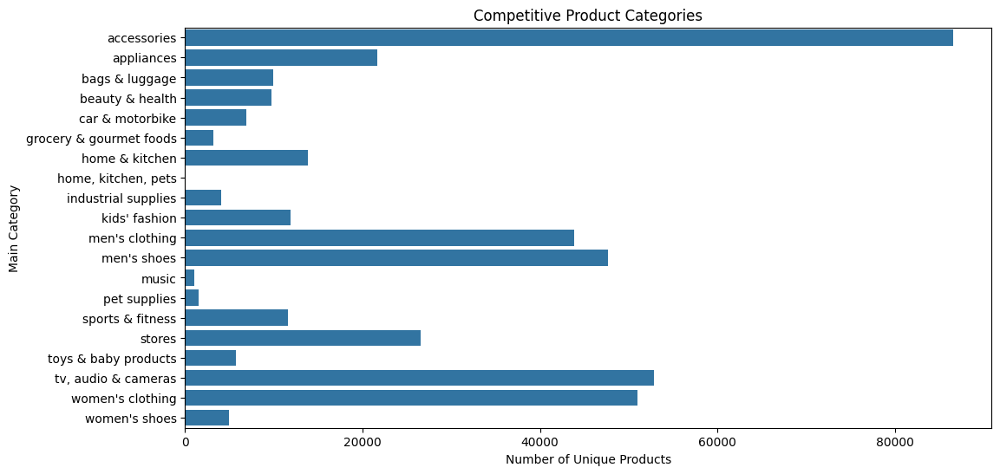

In [165]:
# Create a count plot to show the number of unique products or sellers within each main_category
unique_products_per_category = data.groupby('main_category')['name'].nunique().reset_index()
plt.figure(figsize=(12, 6))
sb.barplot(data=unique_products_per_category, x='name', y='main_category')
plt.title('Competitive Product Categories')
plt.xlabel('Number of Unique Products')
plt.ylabel('Main Category')
plt.show()
# Explain which main categories are the most competitive based on the number of unique products.

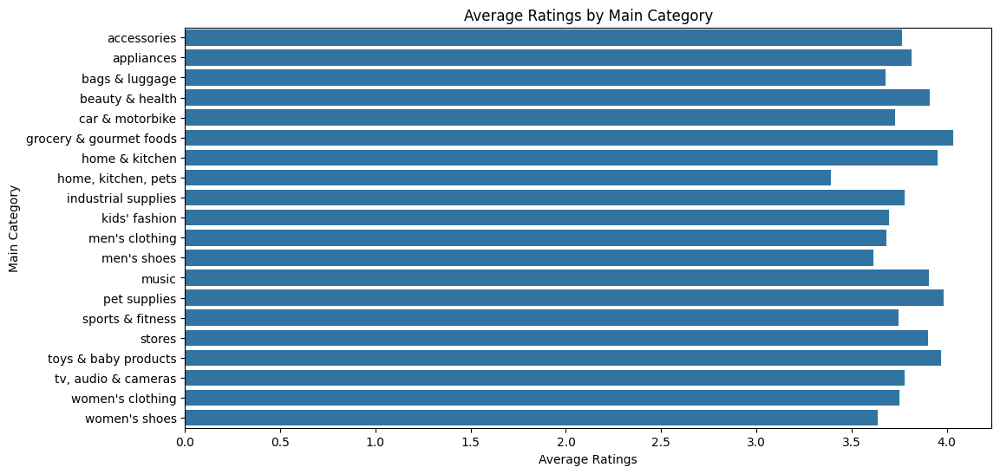

In [166]:

# Create a bar chart to show the average ratings by main_category
avg_ratings_by_category = data.groupby('main_category')['ratings'].mean().reset_index()
plt.figure(figsize=(12, 6))
sb.barplot(data=avg_ratings_by_category, x='ratings', y='main_category')
plt.title('Average Ratings by Main Category')
plt.xlabel('Average Ratings')
plt.ylabel('Main Category')
plt.show()
# Explain the relationship between average ratings and main categories

In [167]:

data.columns

Index(['name', 'Brand_Name', 'main_category', 'sub_category', 'actual_price',
       'discount_price', 'Discount_Offered', 'Discount_per', 'sales_per',
       'ratings', 'Rating_level', 'no_of_ratings'],
      dtype='object')

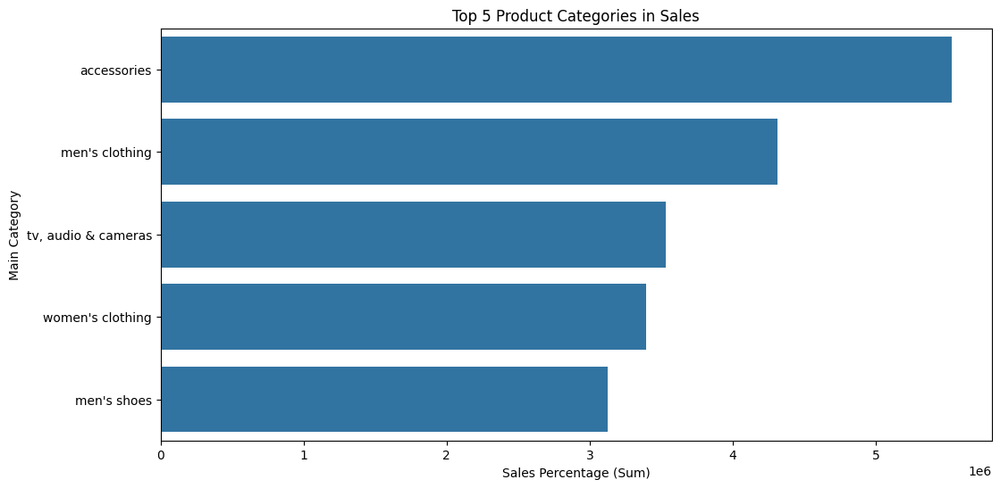

In [168]:
# Create a bar chart to show the top 5 main_category by sales_metric
top_5_categories = data.groupby('main_category')['sales_per'].sum().nlargest(5).reset_index()
plt.figure(figsize=(12, 6))
sb.barplot(data=top_5_categories, x='sales_per', y='main_category')
plt.title('Top 5 Product Categories in Sales')
plt.xlabel('Sales Percentage (Sum)')
plt.ylabel('Main Category')
plt.show()
# Explain the top 5 main categories with the highest sales_metric.

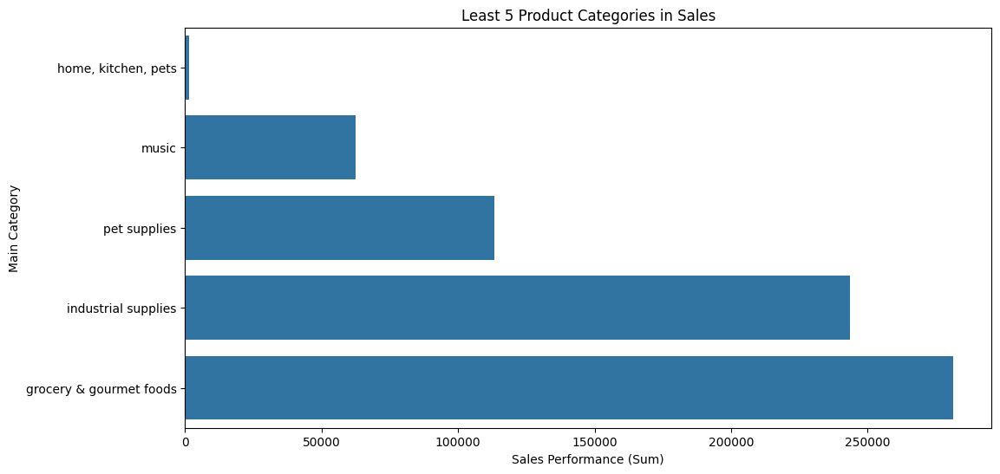

In [169]:
# Create a bar chart to show the least 5 main_category by sales_metric
least_5_categories = data.groupby('main_category')['sales_per'].sum().nsmallest(5).reset_index()
plt.figure(figsize=(12, 6))
sb.barplot(data=least_5_categories, x='sales_per', y='main_category')
plt.title('Least 5 Product Categories in Sales')
plt.xlabel('Sales Performance (Sum)')
plt.ylabel('Main Category')
plt.show()
# Explain the least 5 main categories with the lowest sales_metric.

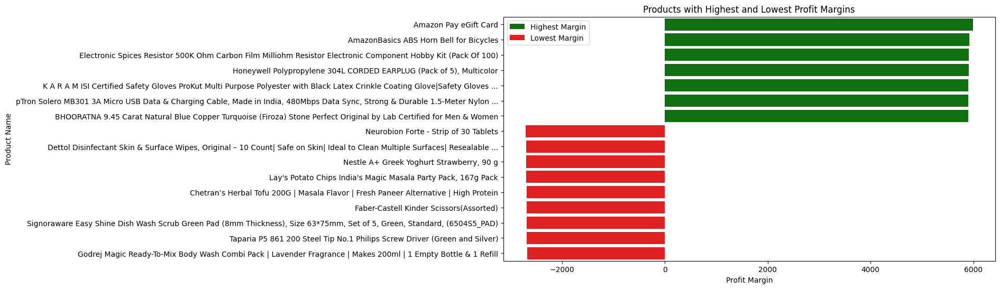

In [170]:

# Calculate profit margins and create a bar chart or list products with the highest and lowest margins
data['profit_margin'] = data['actual_price'] - data['discount_price']
highest_margin_products = data.nlargest(10, 'profit_margin')
lowest_margin_products = data.nsmallest(10, 'profit_margin')
plt.figure(figsize=(12, 6))
sb.barplot(data=highest_margin_products, x='profit_margin', y='name', color='green', label='Highest Margin')
sb.barplot(data=lowest_margin_products, x='profit_margin', y='name', color='red', label='Lowest Margin')
plt.title('Products with Highest and Lowest Profit Margins')
plt.xlabel('Profit Margin')
plt.ylabel('Product Name')
plt.legend()
plt.show()
# Explain the products with the highest and lowest profit margins.

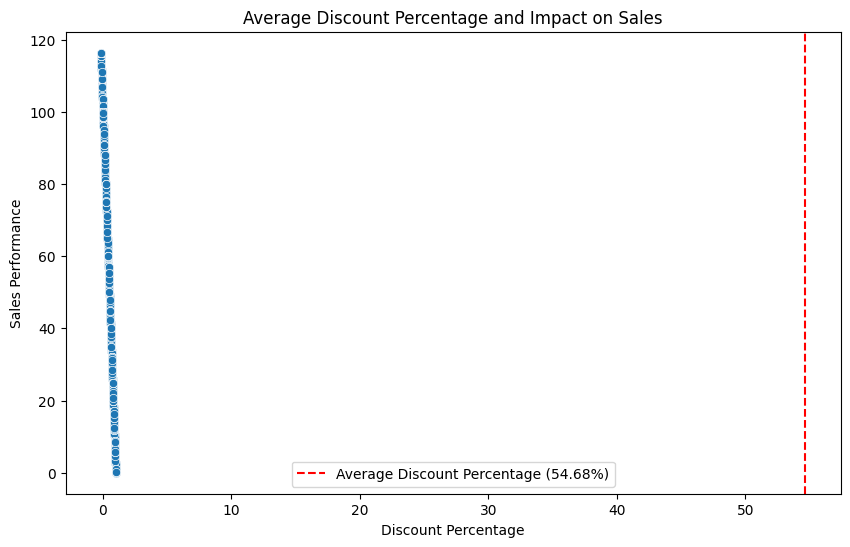

In [171]:
# Calculate average discount percentage for products and analyze its impact on sales_metric
avg_discount_percentage = (data['discount_price'] / data['actual_price']).mean() * 100
plt.figure(figsize=(10, 6))
sb.scatterplot(data=data, x='Discount_per', y='sales_per')
plt.axvline(x=avg_discount_percentage, color='red', linestyle='--', label=f'Average Discount Percentage ({avg_discount_percentage:.2f}%)')
plt.title('Average Discount Percentage and Impact on Sales')
plt.xlabel('Discount Percentage')
plt.ylabel('Sales Performance')
plt.legend()
plt.show()
# Explain the relationship between discount percentage and sales_metric.

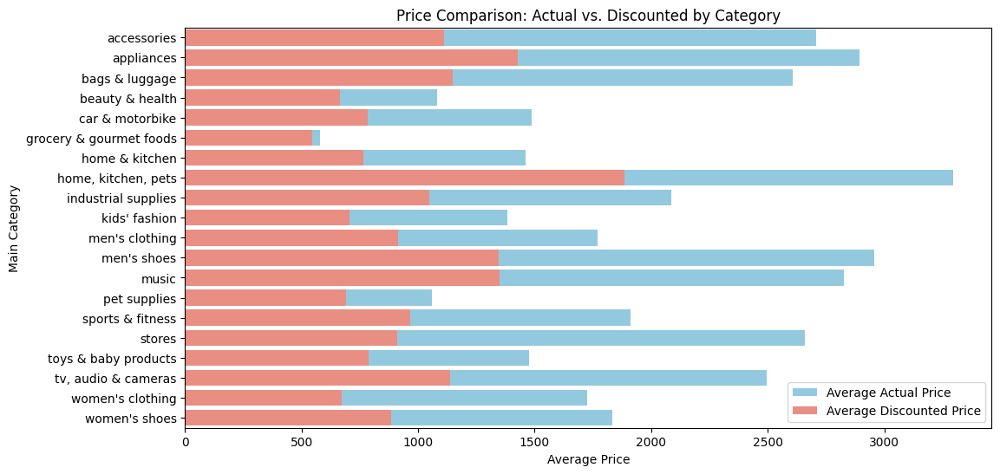

In [172]:
# Create a bar chart to compare the average actual prices and discounted prices by main_category
avg_actual_prices = data.groupby('main_category')['actual_price'].mean().reset_index()
avg_discounted_prices = data.groupby('main_category')['discount_price'].mean().reset_index()
plt.figure(figsize=(12, 6), FigureClass=plt.figure)

sb.barplot(data=avg_actual_prices, x='actual_price', y='main_category', label='Average Actual Price', color='skyblue')
sb.barplot(data=avg_discounted_prices, x='discount_price', y='main_category', label='Average Discounted Price', color='salmon')
plt.title('Price Comparison: Actual vs. Discounted by Category')
plt.xlabel('Average Price')
plt.ylabel('Main Category')
plt.legend()
plt.show()
# Explain how actual prices compare to discounted prices by category.

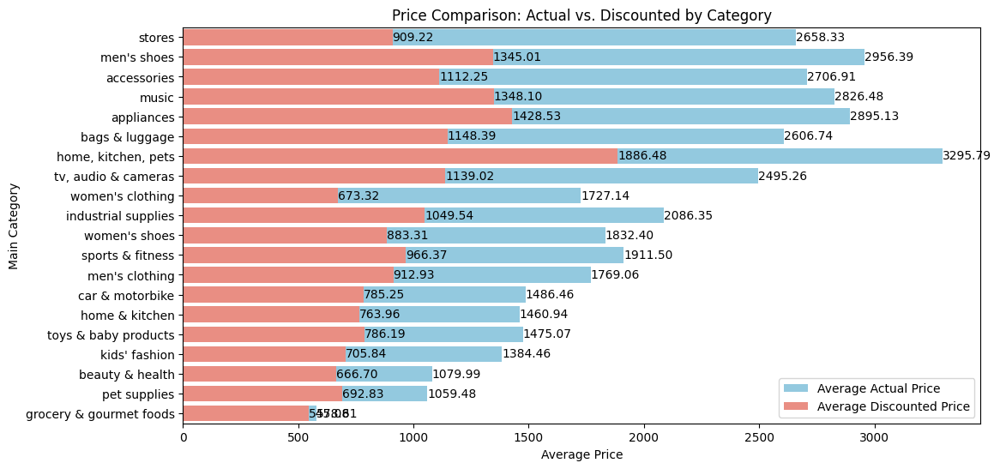

In [173]:

avg_actual_prices = data.groupby('main_category')['actual_price'].mean().reset_index()
avg_discounted_prices = data.groupby('main_category')['discount_price'].mean().reset_index()

avg_price_diff = avg_actual_prices['actual_price'] - avg_discounted_prices['discount_price']
avg_price_diff_df = pd.DataFrame({'main_category': avg_actual_prices['main_category'], 'avg_price_diff': avg_price_diff})

max_diff_category = avg_price_diff_df.loc[avg_price_diff_df['avg_price_diff'].idxmax(), 'main_category']

plt.figure(figsize=(12, 6))

# Define the order of categories based on average price difference
order = avg_price_diff_df.sort_values(by='avg_price_diff', ascending=False)['main_category']

# Plotting average actual prices
ax = sb.barplot(data=avg_actual_prices, x='actual_price', y='main_category',order=order ,label='Average Actual Price', color='skyblue')

# Plotting average discounted prices
sb.barplot(data=avg_discounted_prices, x='discount_price', y='main_category', order=order,label='Average Discounted Price', color='salmon')

# Adding annotations for actual prices
for p in ax.patches:
    ax.annotate(f'{p.get_width():.2f}', (p.get_width(), p.get_y() + p.get_height() / 2),
                ha='left', va='center', color='black', fontsize=10)

plt.title('Price Comparison: Actual vs. Discounted by Category')
plt.xlabel('Average Price')
plt.ylabel('Main Category')
plt.legend()
plt.show()

#Multi variate analysis

In [174]:
numeric_columns=data.select_dtypes(include="number").columns

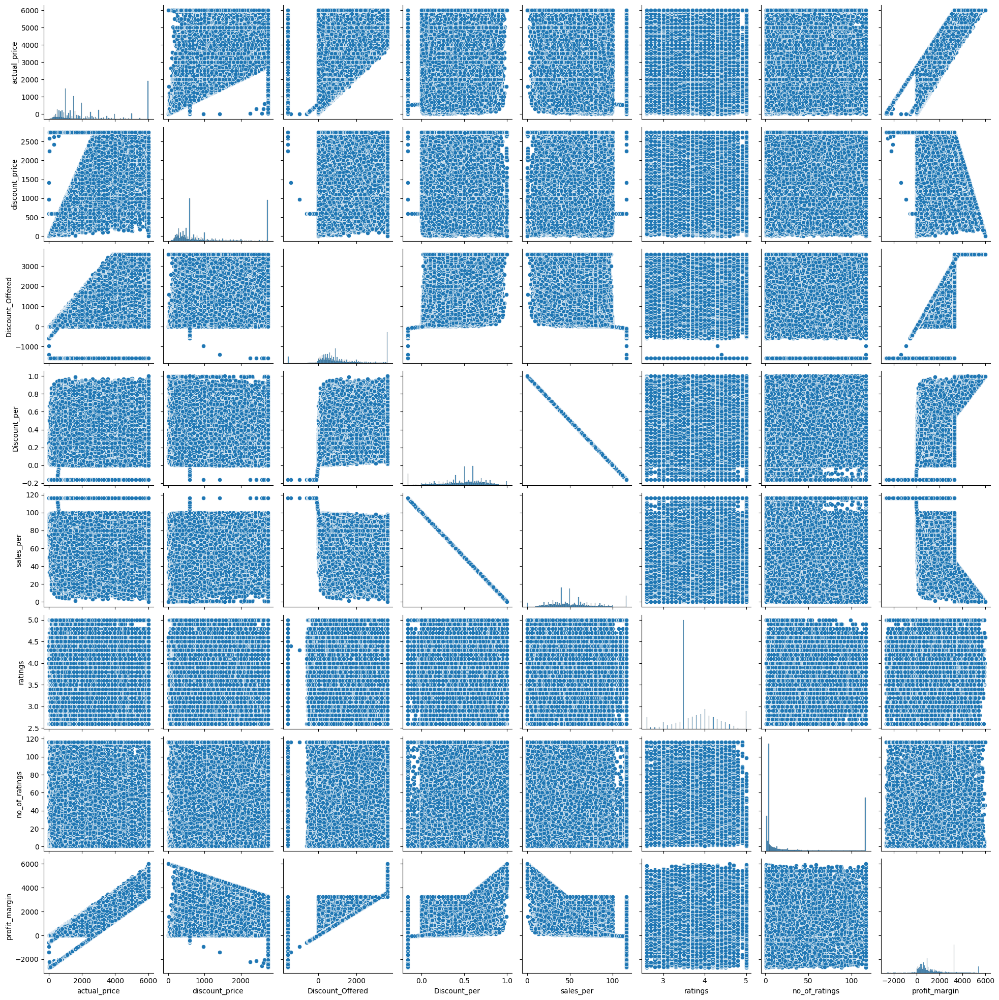

In [175]:
sb.pairplot(data[numeric_columns])

In [176]:
numeric_columns = data.select_dtypes(include="number").columns
print(numeric_columns)

Index(['actual_price', 'discount_price', 'Discount_Offered', 'Discount_per',
       'sales_per', 'ratings', 'no_of_ratings', 'profit_margin'],
      dtype='object')


<Axes: >

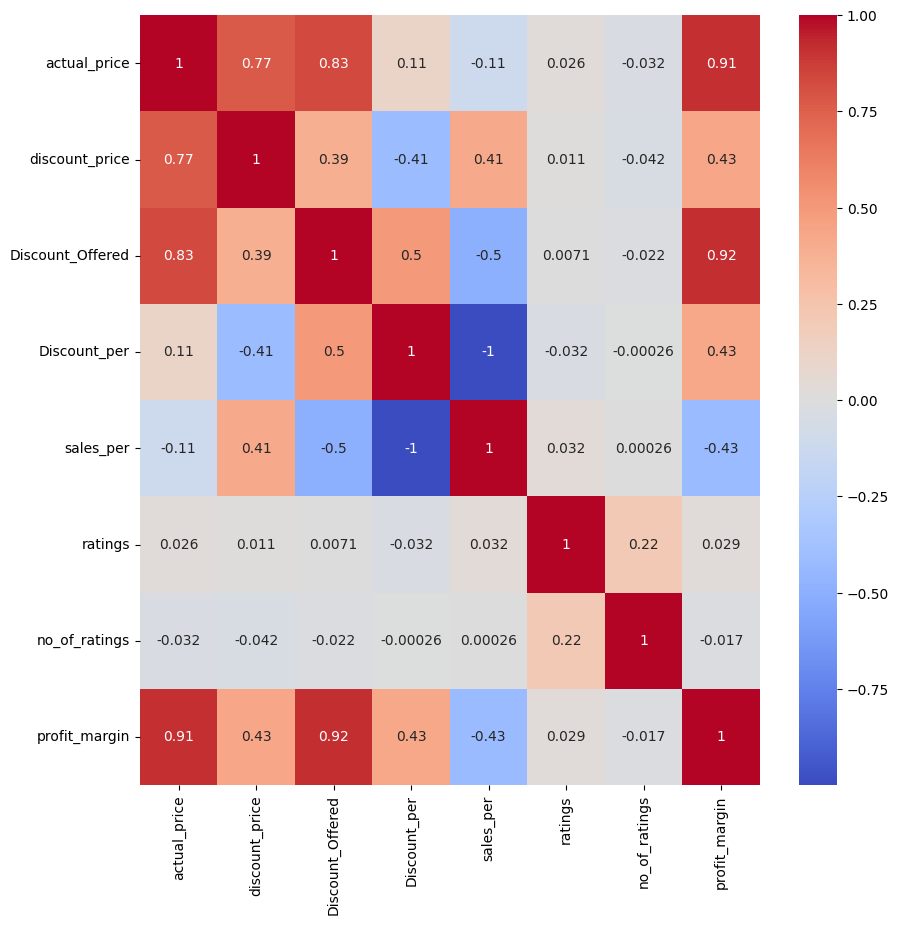

In [177]:

corr = data[numeric_columns].corr()
plt.figure(figsize=(10,10))
sb.heatmap(corr, annot=True, cmap='coolwarm')

#Distribution

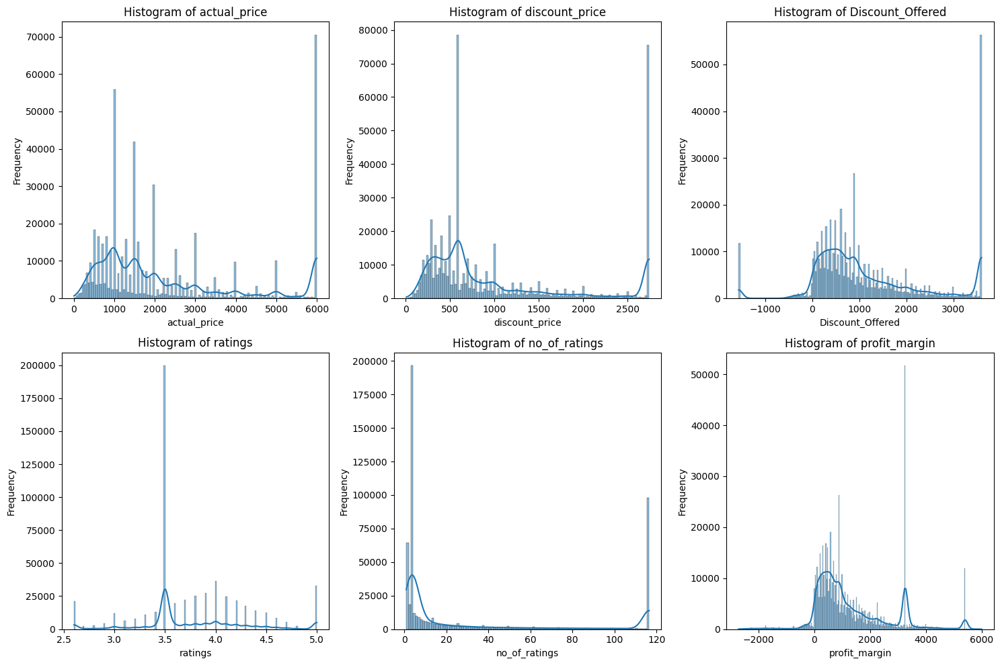

In [178]:

numerical_columns = ['actual_price', 'discount_price', 'Discount_Offered', 'ratings', 'no_of_ratings', 'profit_margin']

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))  # Define the layout of subplots

for i, column in enumerate(numerical_columns):
    row = i // 3  # Calculate the row for the subplot
    col = i % 3   # Calculate the column for the subplot
    sb.histplot(data[column], kde=True, ax=axes[row, col])
    axes[row, col].set_title(f'Histogram of {column}')
    axes[row, col].set_xlabel(column)
    axes[row, col].set_ylabel('Frequency')

plt.tight_layout()  # Adjust layout to prevent overlapping
plt.show()

#Insight

Here by seeing the graph, we can say that non of the graph is normally distributed

Actual_price, Discount_price, Discount_Offered, Ratings, No.of_ratings have right skewed data distribution because, we can observe that the frequency of the data is high in right hand side of graph

In [180]:

for column in numerical_columns:
    print(f"Statistics for {column}:")
    print(f"Mean: {data[column].mean()}")
    print(f"Median: {data[column].median()}")
    print(f"Standard Deviation: {data[column].std()}\n")

Statistics for actual_price:
Mean: 2273.2389967094828
Median: 1499.0
Standard Deviation: 1816.4056513326805

Statistics for discount_price:
Mean: 1013.372029696239
Median: 599.0
Standard Deviation: 842.3925436191876

Statistics for Discount_Offered:
Mean: 1148.4944043075864
Median: 802.0
Standard Deviation: 1165.1085040149635

Statistics for ratings:
Mean: 3.755463981072726
Median: 3.5
Standard Deviation: 0.5374235801895199

Statistics for no_of_ratings:
Mean: 32.35141637281652
Median: 4.0
Standard Deviation: 44.04783396922009

Statistics for profit_margin:
Mean: 1259.8669670132438
Median: 850.0
Standard Deviation: 1286.9314144607563



#Insight

By using these statistical measures, we surely conclude that the data is distributes positive in the entire data set.


Because we observe that mean value is greater than median

According to positive skewness order of statistical measures
mode< median< mean

In [181]:
import scipy.stats as stats

In [182]:
# Identify distribution types
for column in numerical_columns:
    print(f"Distribution type for {column}: {stats.normaltest(data[column])}")

Distribution type for actual_price: NormaltestResult(statistic=71328.19009633732, pvalue=0.0)
Distribution type for discount_price: NormaltestResult(statistic=80501.54805452723, pvalue=0.0)
Distribution type for Discount_Offered: NormaltestResult(statistic=43129.065936540464, pvalue=0.0)
Distribution type for ratings: NormaltestResult(statistic=17967.26587022675, pvalue=0.0)
Distribution type for no_of_ratings: NormaltestResult(statistic=88277.43134758572, pvalue=0.0)
Distribution type for profit_margin: NormaltestResult(statistic=96058.19914522018, pvalue=0.0)


AS p_val is less than 0.05 we reject the null hypothesis.so the data doesnot follow a normal distribution in of these columns

In [183]:
data['normalized_ratings'] = data['ratings'].apply(lambda x: np.log(x) if x > 0 else 0)

In [184]:
print(f"Distribution type for normalized_ratings: {stats.normaltest(data['normalized_ratings'])}")

Distribution type for normalized_ratings: NormaltestResult(statistic=3770.009681021775, pvalue=0.0)


In [185]:
data['normalized_discount_price'] = data['discount_price'].apply(lambda x: np.log(x) if x > 0 else 0)

In [186]:
print(f"Distribution type for normalized_ratings: {stats.normaltest(data['normalized_discount_price'])}")

Distribution type for normalized_ratings: NormaltestResult(statistic=22217.72913214297, pvalue=0.0)


#Hypothesis Testing

In [187]:
import scipy.stats as stats

#ANOVA TESTING

The ANOVA (Analysis of Variance) test is a way to find out if survey or experiment results are significant

###Outputs

F-statistics: Ratio of the variance between the groups to the variance within the groups

P-value: Probability of obtainging an F-statistic extreme than the observed value

A comparison of average sales percentages across different main categories using ANOVA test.

     we only get the result for "Is there any significant differance betweeen each group"
     but we cant specify which two group differ from each other - for this we need to perform post hoc test

##Assumptions

Null hypothesis: There’s no difference in the means of brands

Alternative hypothesis: Theres is a differnace in the means of brands

In [188]:
# Group the data by main category and calculate the mean sales percentage by each main category
main_cat_groups = data.groupby('main_category')['sales_per'].mean()

# Perform ANOVA test
f_val, p_val = stats.f_oneway(*[data.loc[data['main_category'] == category, 'sales_per'] for category in main_cat_groups.index])
#  "*" is used for unpacking the list of series into separate arguments
# here we are only selecting the rows that is equal to category(loc used to select a subset of the dataframe based on certain condition)

f_val, p_val

(1797.4265173063473, 0.0)

Here we perform the one way ANOVA test, which tests the null hypothesis that two or more groups have the same populaltion mean.

In [189]:
print(p_val)

0.0


In [190]:
if p_val<0.05:
    print("reject null hypothesis")
else:
    print("accept null hypothesis")

reject null hypothesis


so we conclude that there is a differance in the means of the main categories

# T-TEST


performing a two-sample t-test to compare the average discount offered on products between Brand A and Brand B

In [ ]:
brand_list=list(data['Brand_Name'].unique())
['Lloyd', 'LG', 'Carrier', 'Voltas', 'Daikin', 'Panasonic', 'Whirlpool', 'Samsung', 'Godrej', 'Blue', 'IFB', 'Cruise', 'AmazonBasics', 'Haier', 'Hitachi', 'Amazon',
 'OGENERAL', 'Small', 'ALLWIN', 'Hexzone', 'Candy', 'O-General', 'ONIDA']
# print(brand_list)
print("Select any two from above")
Brand_A = input("Enter Brand A name(Check Capitals and small letters): ")
Brand_B = input("Enter Brand B name(Check Capitals and small letters): ")

if Brand_A in brand_list and Brand_B in brand_list:
     brand_a_data = data[data['Brand_Name'] == Brand_A]
     brand_b_data = data[data['Brand_Name'] == Brand_B]

     # Extract the discount offered for each brand
     discount_offered_a = brand_a_data['Discount_Offered']
     discount_offered_b = brand_b_data['Discount_Offered']

     # Perform the two-sample t-test
     t_statistic, p_value =stats.ttest_ind(discount_offered_a, discount_offered_b)

     # Print the results
     print('t-statistic:', t_statistic)
     print('p-value:', p_value)

     # Interpret the results
     if p_value < 0.05:
         print('There is a significant difference in the average discount offered on products between Brand A ({}) and Brand B ({}).'.format(Brand_A, Brand_B))
     else:
         print('There is no significant difference in the average discount offered on products between Brand A ({}) and Brand B ({}).'.format(Brand_A, Brand_B))


else:
    print("Give the brand names correctly, please go throught the list once again")

#Conclusion

if the p_val is lessthan 0.05 then

        statistically, the two brands offer similar discounts on their products
else

        statistically, the two brands does not offer similar discounts on their products

# PEARSON CORRELATION

In [192]:
# Perform the Pearson correlation test
correlation_coefficient, p_value = stats.pearsonr(data['sales_per'], data['no_of_ratings'])

# Print the results
print('Correlation coefficient:', correlation_coefficient)
print('p-value:', p_value)

if abs(correlation_coefficient) > 0.3 and p_value < 0.05:
    print('There is a weak to moderate significant relationship between the average sales percentage product and the number of ratings a product has.')
elif abs(correlation_coefficient) > 0.5 and p_value < 0.05:
    print('There is a moderate to strong significant relationship between the average sales percentage product and the number of ratings a product has.')
elif abs(correlation_coefficient) > 0.8 and p_value < 0.05:
    print('There is a strong significant relationship between the average sales percentage product and the number of ratings a product has.')
else:
    print('There is no significant relationship between the average sales percentage product and the number of ratings a product has.')

Correlation coefficient: 0.00025784432679744687
p-value: 0.8481359362952517
There is no significant relationship between the average sales percentage product and the number of ratings a product has.


The correlation coefficient measures the strength and direction of the linear relationship between two variables

0.00025 indicate a very weak correlation is statistically significant

#CENTRAL LIMIT THEOREM

In [193]:

df= data[['ratings']]
df

,ratings
0,4.2
1,4.2
2,4.2
3,4.0
4,4.1
...,...
551580,3.2
551581,2.6
551582,4.0
551583,4.4


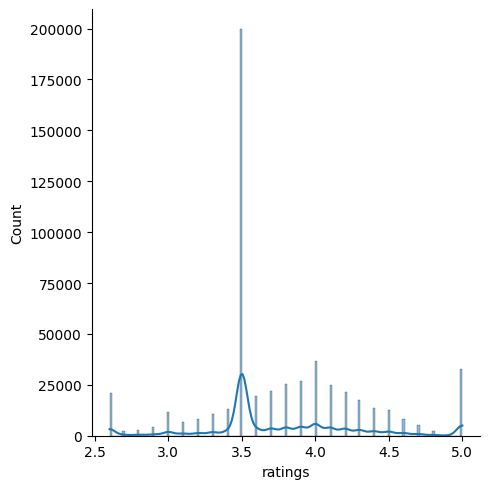

In [194]:

sb.displot(df.ratings,kde=True)
plt.show()

##Population Mean

In [195]:

df.ratings.mean()

3.755463981072726

This is the true mean weight of the population. This is the population parameter, the ground truth.

Let's take a random sample from this data, and see what mean we get.

###Sample Mean

In [196]:

sample_size= 30

In [197]:
df.ratings.sample(sample_size).mean()

3.753333333333333


Slight different from the population mean, right?
Let's take another sample.

In [198]:
df.ratings.sample(sample_size).mean()

3.786666666666667

Each time we take a sample, our mean value is different. There is variability in the sample mean itself. Does the sample mean itself follow a distribution? Let's assess this.
We'll take many samples from the data, and plot a histogram of the same.

In [199]:

sample_means = [df.ratings.sample(sample_size).mean() for i in range(1000)]
sample_means = pd.Series(sample_means)

<ipython-input-200-4f6874b66c9d>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(sample_means)


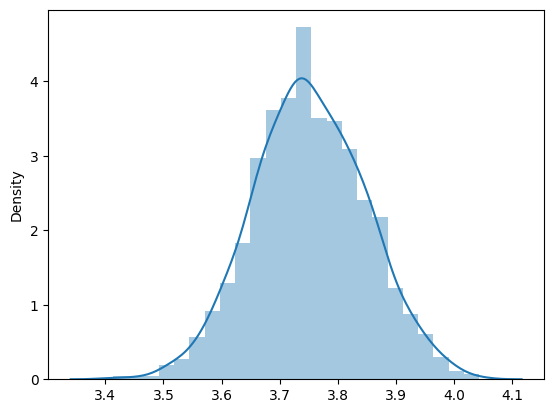

In [200]:

sb.distplot(sample_means)
plt.show()

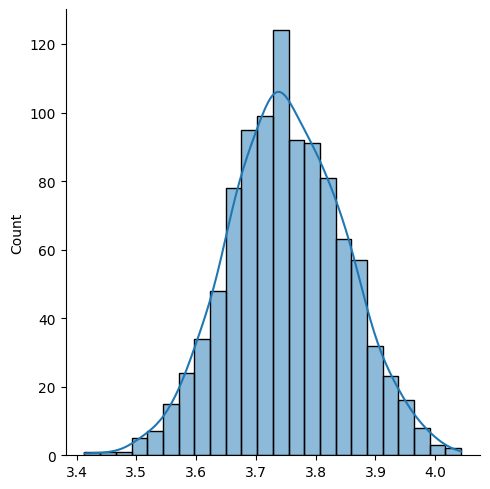

In [201]:
sb.displot(sample_means,kde=True)
plt.show()

It is a distribution of sample means, which is a histogram with a Kernel Density Estimate (KDE) overlay. This type of distribution is known as a Sampling Distribution.

From the plot, it appears that the distribution of sample means follows a Normal Distribution (also known as a Gaussian Distribution), which is characterized by its bell shape and symmetry around the mean. This is in line with the Central Limit Theorem, which states that the distribution of sample means will approximate a normal distribution as the sample size becomes large, regardless of the shape of the population distribution.

The mean of this distribution is approximately 3.75, which is the peak of the bell curve. This suggests that the average rating across all samples is around 3.75. The spread of the distribution gives us an idea about the variability of the ratings. The narrower the bell curve, the less variability there is in the ratings.

##Mean of the sample means

In [202]:
sample_means.mean()

3.7519

##Standard deviation of your sample means

In [203]:

sample_means.std()

0.0967021036607165

##standard error of the population

Population std vs. std of sampling mean

In [205]:
df.ratings.std()/np.sqrt(sample_size)

0.09811967260166218

#CONCLUSION

The values were very close, which supports the CLT. This implies that the sample means provide a good estimate of the population mean, and the spread of the sample means around this estimate is captured by the standard deviation of the sample means (or equivalently, the standard error of the population).


The analysis provides evidence that the ‘ratings’ data is well-behaved and suitable for statistical inference